In [1]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
import sys
import os
import glob
import numpy as np
import pandas as pd
import dask.dataframe as dd
import xarray as xr
import hvplot.xarray  # noqa
import seaborn as sns
from dask import delayed, compute
import itertools
from pytmatrix import tmatrix_aux, refractive, tmatrix, radar
from pymiecoated import Mie
from scipy.constants import c
from scipy import stats as ss
from scipy.optimize import minimize
from scipy.optimize import brentq
from scipy.special import gamma
from sqlalchemy.exc import OperationalError
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.metrics import davies_bouldin_score, silhouette_score
from yellowbrick.cluster import SilhouetteVisualizer
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.patches import Rectangle
from matplotlib.colors import LinearSegmentedColormap
from re import split
import matplotlib.dates as mdates
from dask_jobqueue import SLURMCluster
from dask.distributed import Client, progress
import matplotlib.pylab as pl
from dask import delayed, compute
from metpy.calc import pressure_to_height_std as p2h
from metpy.calc import lcl
import cartopy.crs as ccrs
import cartopy
import cartopy.mpl.ticker as cticker
import cartopy.io.img_tiles as cimgt
import cartopy.feature as cfeature
import warnings
import cython
warnings.filterwarnings('ignore')


sys.path.insert(1, f"{os.path.abspath(os.path.join(os.path.abspath(''), '../'))}")
from src.utils import get_pars_from_ini, make_dir

location = split(', |_|-|!', os.popen('hostname').read())[0].replace("\n", "")
path_data = get_pars_from_ini(file_name='loc')[location]['path_data']

/data/keeling/a/alfonso8/miniconda3/envs/camp2ex_proj/lib/python3.9/site-packages/dask_jobqueue/core.py:20: FutureWarning: tmpfile is deprecated and will be removed in a future release. Please use dask.utils.tmpfile instead.
  from distributed.utils import tmpfile


In [2]:
def norm_gamma(d, nw, mu, dm):
    f_mu = (6 * (4 + mu) ** (mu + 4)) / (4 ** 4 * gamma(mu + 4) )
    slope = (4 + mu) / dm
    return nw * f_mu * (d / dm) ** mu * np.exp(-slope * d)

In [3]:
cluster = SLURMCluster(queue="seseml",
                       memory='50GB',
                       cores=20,
                       processes=1,
                       walltime='24:00:00', 
#                        scheduler_options={
#                            'host': '172.22.179.3:7224', 
#                            'dashboard_address': ':7798'
#                        }
                      )

cluster.scale(jobs=1)
cluster

In [4]:
client = Client(cluster)
client

Connection method: Cluster object,Cluster type: dask_jobqueue.SLURMCluster
Dashboard: /proxy/44460/status,
Dashboard: /proxy/44460/status,Workers: 0
Total threads: 0,Total memory: 0 B
Comm: tcp://172.22.178.61:34653,Workers: 0
Dashboard: /proxy/44460/status,Total threads: 0
Started: Just now,Total memory: 0 B


In [5]:
%%bash
squeue -u $USER

             JOBID PARTITION     NAME     USER ST       TIME  NODES NODELIST(REASON)
           1692328      node interact alfonso8  R    3:59:57      1 keeling-g01
           1692423    seseml dask-wor alfonso8 PD       0:00      1 (Priority)
           1692418    seseml dask-wor alfonso8  R      27:39      1 keeling-h13


In [8]:
aircraft = 'Lear'
aircraft2 = 'Learjet'
aircraft1 = 'P3B'
aircraft3 = 'P3B'

In [9]:
store = f"{path_data}/cloud_probes/zarr/dm_retrieved_Lear.zarr"
store1 = f"{path_data}/cloud_probes/zarr/combined_psd_Lear_600_1000_5_bins_merged.zarr"
store2 = f"{path_data}/cloud_probes/zarr/combined_psd_P3B_600_1000_5_bins_merged.zarr"
store3 = f"{path_data}/cloud_probes/zarr/dm_retrieved_P3B.zarr"


In [13]:
f"{path_data}/cloud_probes/zarr/combined_psd_Lear_600_1000_5_bins_merged.zarr"

'/data/keeling/a/alfonso8/gpm/camp2ex/cloud_probes/zarr/combined_psd_Lear_600_1000_5_bins_merged.zarr'

In [10]:
# lear
ds_lear = xr.open_zarr(store1)
ds_p3b = xr.open_zarr(store2)

In [11]:
ds = xr.concat([ds_lear, ds_p3b], dim='time')

In [12]:
ds

<xarray.Dataset>
Dimensions:      (time: 8745, diameter: 58)
Coordinates:
  * diameter     (diameter) float64 50.0 60.0 70.0 ... 3.524e+03 3.824e+03
  * time         (time) datetime64[ns] 2019-09-07T00:50:13 ... 2019-10-05T07:...
Data variables: (12/37)
    A_ka         (time, diameter) float64 dask.array<chunksize=(1012, 29), meta=np.ndarray>
    A_ku         (time, diameter) float64 dask.array<chunksize=(1012, 29), meta=np.ndarray>
    A_w          (time, diameter) float64 dask.array<chunksize=(1012, 29), meta=np.ndarray>
    Att_ka       (time) float64 dask.array<chunksize=(4046,), meta=np.ndarray>
    Att_ku       (time) float64 dask.array<chunksize=(4046,), meta=np.ndarray>
    Att_w        (time) float64 dask.array<chunksize=(4046,), meta=np.ndarray>
    ...           ...
    sigma        (time) float64 dask.array<chunksize=(4046,), meta=np.ndarray>
    sigmap       (time) float64 dask.array<chunksize=(4046,), meta=np.ndarray>
    sigmasqr     (time) float64 dask.array<chunksize=(4046,), meta=np.ndarray>
    temp         (time) float64 dask.array<chunksize=(4046,), meta=np.ndarray>
    vert_vel     (time) float64 dask.array<chunksize=(4046,), meta=np.ndarray>
    z            (time, diameter) float64 dask.array<chunksize=(1012, 29), meta=np.ndarray>
Attributes: (12/14)
    LWC:              units gm-3
    RH:               method Lear-Computed, P3B-Measured
    altitude:         units Lear (ft), P3B (m)
    combined_pds:     units: # l um-1
    d_d:              bin lenght in mm
    dew_point:        units Celcius
    ...               ...
    reflectivity_Ka:  units mm6 mm-3
    reflectivity_Ku:  units mm6 mm-3
    reflectivity_W:   units mm6 mm-3
    temp:             units Celcius
    time:             UTC
    vert_vel:         units ms-1

In [10]:
ds_pca = ds[['sigma', 'sigmap', 'dm', 'log10_nw', 'mu', 'r', 'dfr', 'dbz_t_ka', 'dbz_t_ku', 'nt', 'lwc_cum', 'temp', 'vert_vel', 'altitude', "new_mu"]]
ds_pca['logr'] = np.log10(ds.r)
ds_pca['lognt'] = np.log10(ds.nt)
ds_pca['loglwc'] = np.log10(ds.lwc_cum)

In [11]:
df = ds_pca.to_dataframe().reset_index().dropna()
df = df[~(df['time'] == '2019-09-09 00:54:08')]

In [12]:
scaler = StandardScaler()
df[['sigma_T', 'dm_T', 'log10_nw_T', 'logr_T', 'lognt_T', "loglwc_T"]]= scaler.fit_transform(df[['sigma', 'dm', 'log10_nw', 'logr', 'lognt', 'loglwc']])

In [13]:
n_c = 6
X = df[['sigma_T', 'dm_T', 'log10_nw_T', 'logr_T', 'lognt_T', "loglwc_T"]]
kmeans = KMeans(n_clusters=n_c, random_state=10)
kmeans.fit(X)

KMeans(n_clusters=6, random_state=10)

In [14]:
df['kmeans_6'] = kmeans.labels_

In [15]:
from matplotlib.colors import ListedColormap

# construct cmap
flatui = ["#9b59b6", "#3498db", "#95a5a6", "#e74c3c", "#34495e", "#2ecc71"]
my_cmap6 = ListedColormap(sns.color_palette(flatui).as_hex())

colors6 = my_cmap6(np.linspace(0,1,n_c))

In [16]:
sns.set(rc={"figure.dpi":120, 'savefig.dpi':120})

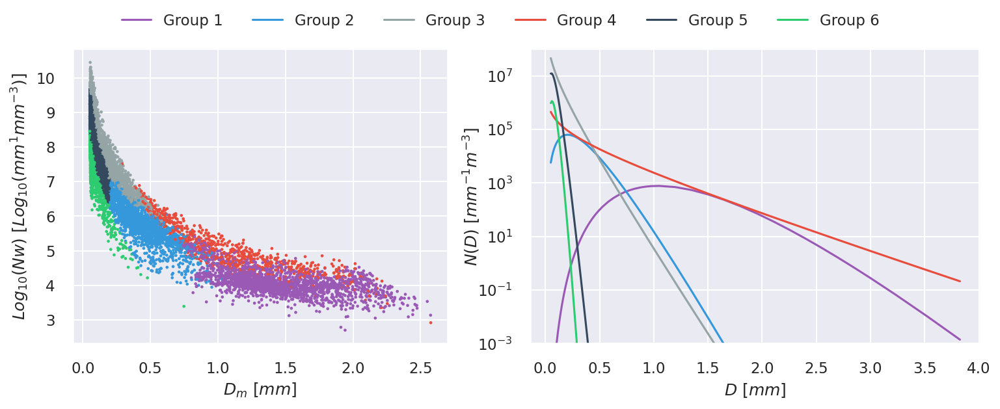

In [17]:
fig, (ax, ax1) = plt.subplots(1, 2, figsize=(12,4), dpi=150,  gridspec_kw={'width_ratios': [1, 1.2]})
sc = ax.scatter(df['dm'], df['log10_nw'], c=df['kmeans_6'], s=1.5, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
# fig.colorbar(sc, ax=ax, label="Group number")

ax1.set_yscale('log')
ax1.set_ylim(1e-3, 1e8)
d = ds.diameter/1000
ax1.grid('both')
n = df['kmeans_6'].max() + 1
ax1.set_ylabel("$N(D) \  [mm^{-1}m^{-3}]$", labelpad=-3)
ax1.set_xlabel("$D\ [mm]$")
# colors = pl.cm.jet(np.linspace(0,1,n))
for i in range(0,n):
    df_sub = df[df['kmeans_6'] == i]
    mu = df_sub['mu'].mean()
    dm = df_sub['dm'].mean()
    nw = 10 ** (df_sub['log10_nw'].mean())
    gm = norm_gamma(d, nw=nw, mu=mu, dm=dm)
    ax1.plot(ds.diameter/1000, gm, c=colors6[i], label=f"Group {i + 1}")
# ax1.legend()

lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels, loc='upper center', ncol=6)

# plots 

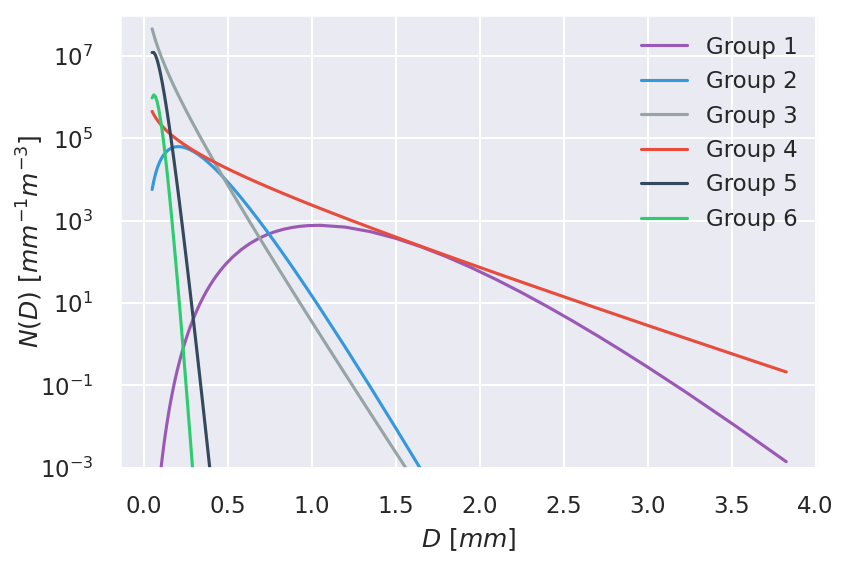

In [18]:
fig, ax1 = plt.subplots(figsize=(6,4), dpi=150)
ax1.set_yscale('log')
ax1.set_ylim(1e-3, 1e8)
d = ds.diameter/1000
ax1.grid('both')
n = df['kmeans_6'].max() + 1
ax1.set_ylabel("$N(D) \  [mm^{-1}m^{-3}]$", labelpad=-3)
ax1.set_xlabel("$D\ [mm]$")
# colors = pl.cm.jet(np.linspace(0,1,n))
for i in range(0,n):
    df_sub = df[df['kmeans_6'] == i]
    mu = df_sub['mu'].mean()
    dm = df_sub['dm'].mean()
    nw = 10 ** (df_sub['log10_nw'].mean())
    gm = norm_gamma(d, nw=nw, mu=mu, dm=dm)
    ax1.plot(ds.diameter/1000, gm, c=colors6[i], label=f"Group {i + 1}")
ax1.legend()

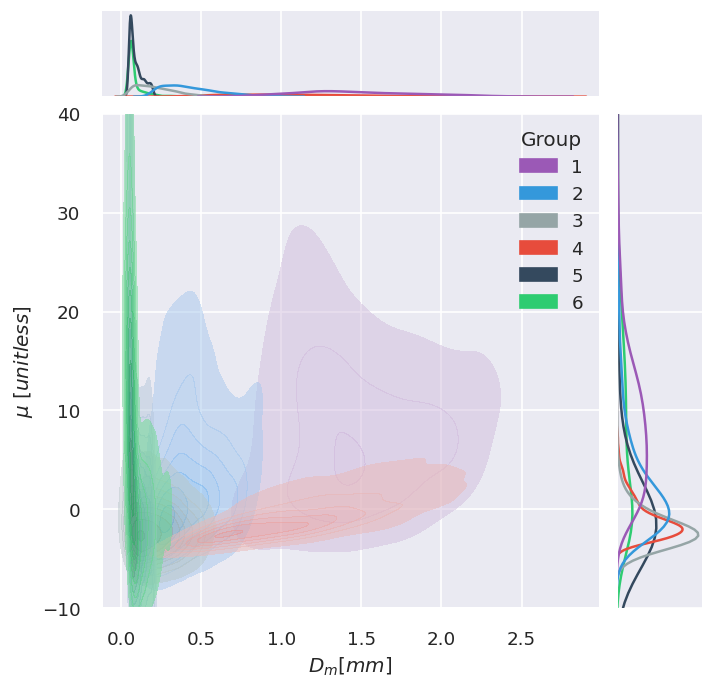

In [19]:
# df =  df[(df['mu'] < 20)]
labels = ['1', '2', '3', '4', '5', '6']
p = sns.jointplot(data=df.rename(columns={"kmeans_6": "Group"}).replace({i: i + 1 for i in df.rename(columns={"kmeans_6": "Group"})['Group'].unique()}), 
                  x="dm", y="mu", kind="kde", hue="Group", palette=sns.color_palette(flatui).as_hex(), 
                  shade=True, alpha=.5,)
p.fig.subplots_adjust(top=0.95)
p.set_axis_labels(r"${D_m [mm]}$", r"${\mu \  [unitless]}$",)
p.ax_marg_y.set_ylim(-10, 40)
# p._legend.remove()
ax = plt.gca()
plt.show()

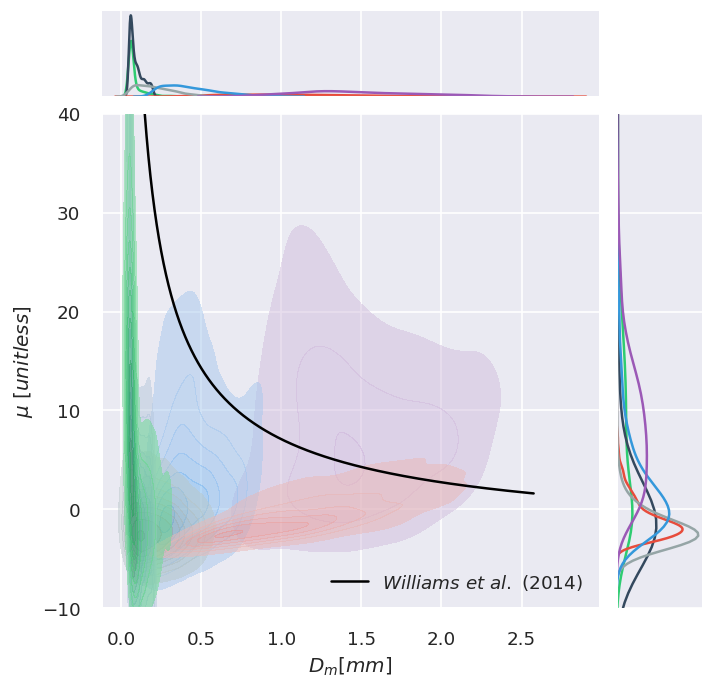

In [20]:
# df =  df[(df['mu'] < 20)]
labels = ['1', '2', '3', '4', '5', '6']
df['mu_dm'] = 11.1 * df['dm'] ** (-0.72) - 4
p = sns.jointplot(data=df.rename(columns={"kmeans_6": "Group"}).replace({i: i + 1 for i in df.rename(columns={"kmeans_6": "Group"})['Group'].unique()}), 
                  x="dm", y="mu", kind="kde", hue="Group", palette=sns.color_palette(flatui).as_hex(), 
                  shade=True, alpha=.5, legend='auto')
p.fig.subplots_adjust(top=0.95)
p.set_axis_labels(r"${D_m [mm]}$", r"${\mu \  [unitless]}$",)
p.ax_marg_y.set_ylim(-10, 40)
ln = sns.lineplot(data=df, x='dm', y='mu_dm',color='black', ax=p.ax_joint, label=r"$Williams \ et \ al. \ (2014)$", legend='full')
sns.move_legend(ln, 'lower right')
# p._legend.remove()
ax = plt.gca()
plt.show()

In [21]:
br = np.arange(0.5, 5.5, 0.001)
# _res = np.zeros_like(br)
res = np.zeros_like(br)
for i in range(br.shape[0]):
    res[i] = np.corrcoef(df['dm'], df['sigma'] / df['dm'] ** br[i])[0, 1] ** 2
bm = br[np.argmin(res)]

In [22]:
df['mu_camp2ex'] = ((df['dm'] ** (2 - 2 * bm)) / (df['sigmap'].mean() ** 2)) - 4

In [23]:
df['mu_williams'] = 11.1 * df['dm'] ** (-0.72) - 4

In [24]:
def rain_retrieval(nw, mu, dm, d, d_d, vel_m='lerm'):
    lerm_vel: Callable[[float], float] = lambda diam: 9.25 * (1 - np.exp(-0.068 * diam ** 2 - 0.488 * diam))  # d in mm
    ulbr_vel: Callable[[float], float] = lambda diam: 3.78 * diam ** 0.67  # with d in mm
    if vel_m == 'lemr':
        vel = lerm_vel(d)
    else:
        vel = ulbr_vel(d)
    f_mu = (6 * (mu + 4) ** (mu + 4)) / (4 ** 4 * gamma(mu + 4))
    r = 6 * np.pi * 1e-4 * (nw * f_mu * (d / dm) ** mu * np.exp(-(4 + mu) * (d / dm)) * vel * d ** 3 * d_d)
    return

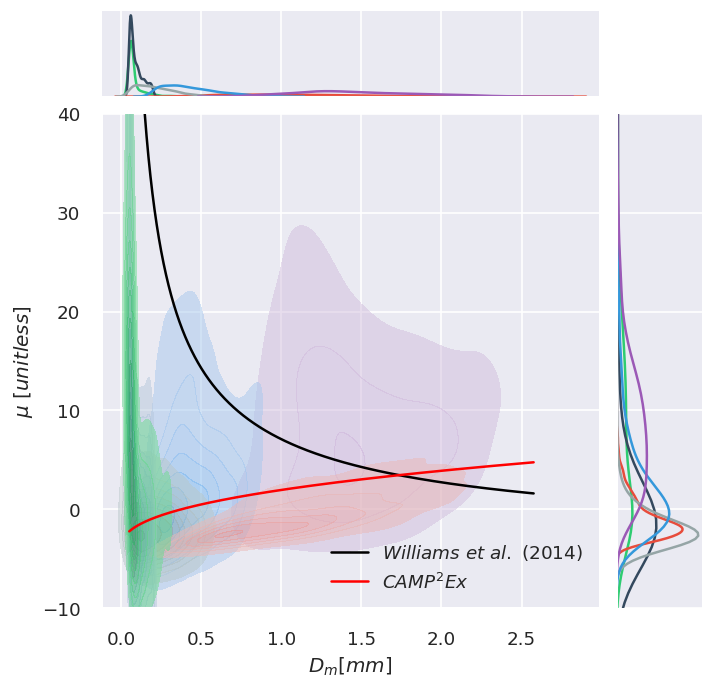

In [25]:
# df =  df[(df['mu'] < 20)]
labels = ['1', '2', '3', '4', '5', '6']
df['mu_dm'] = 11.1 * df['dm'] ** (-0.72) - 4
p = sns.jointplot(data=df.rename(columns={"kmeans_6": "Group"}).replace({i: i + 1 for i in df.rename(columns={"kmeans_6": "Group"})['Group'].unique()}), 
                  x="dm", y="mu", kind="kde", hue="Group", palette=sns.color_palette(flatui).as_hex(), 
                  shade=True, alpha=.5, legend='auto')
p.fig.subplots_adjust(top=0.95)
p.set_axis_labels(r"${D_m [mm]}$", r"${\mu \  [unitless]}$",)
p.ax_marg_y.set_ylim(-10, 40)
ln = sns.lineplot(data=df, x='dm', y='mu_dm',color='black', ax=p.ax_joint, label=r"$Williams \ et \ al. \ (2014)$", legend='full')
ln2 = sns.lineplot(data=df, x='dm', y='mu_camp2ex',color='red', ax=p.ax_joint, label=r"$CAMP^{2}Ex$")
sns.move_legend(ln, 'lower right')
# p._legend.remove()
ax = plt.gca()
plt.show()

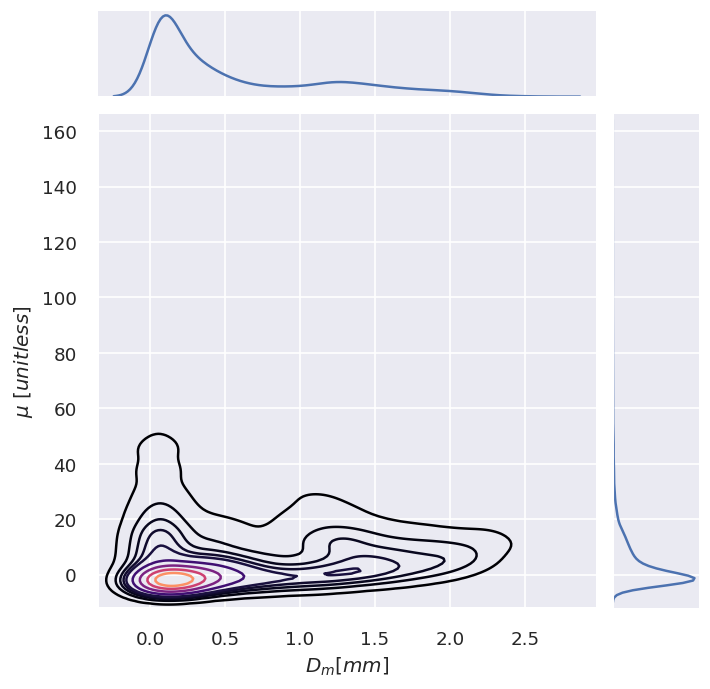

In [26]:
# df = ds[['dm', 'new_mu']].to_dataframe().reset_index()
# df = df.replace([np.inf, -np.inf], np.nan).dropna()
# df =  df[(df['new_mu'] < 20)]
p = sns.jointplot(data=df, x="dm", y="mu", kind="kde", cmap='magma')
p.fig.subplots_adjust(top=0.95)
p.set_axis_labels(r"${D_m [mm]}$", r"${\mu \  [unitless]}$",)
# p.ax_marg_y.set_ylim(-10, 40)
plt.show()

Text(0, 0.5, '$\\sigma \\ [mm] $')

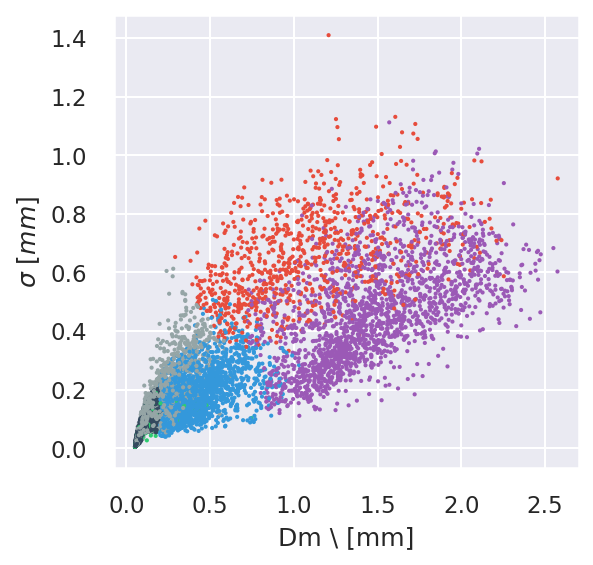

In [27]:
fig, ax = plt.subplots(figsize=(4, 4), dpi=150)
ax.scatter(df.dm, df.sigma, c=df['kmeans_6'], s=1, cmap=my_cmap6)
ax.set_xlabel("Dm \ [mm]")
ax.set_ylabel(r"$\sigma \ [mm] $")

Text(0, 0.5, '$Log_{10}(R) \\ [Log_{10}(mm hr^{-1})]$')

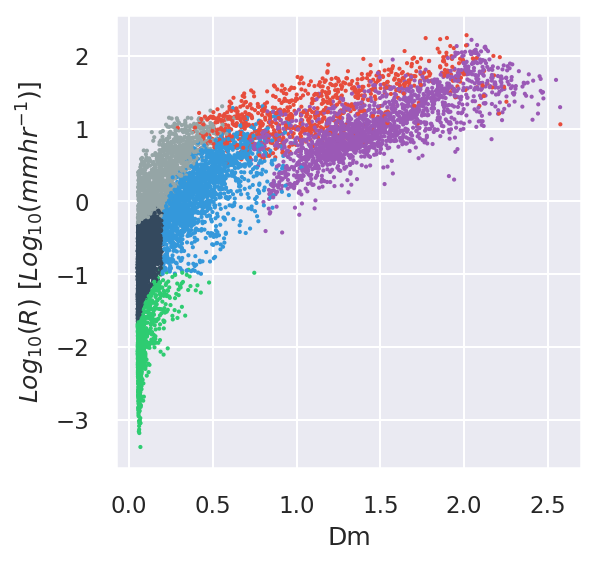

In [28]:
fig, ax = plt.subplots(figsize=(4, 4), dpi=150)
ax.scatter(df.dm, df.logr, c=df['kmeans_6'], s=1, cmap=my_cmap6)
ax.set_xlabel("Dm")
ax.set_ylabel(r"$Log_{10}(R) \ [Log_{10}(mm hr^{-1})]$")

(0.00022034660706400273, 200)

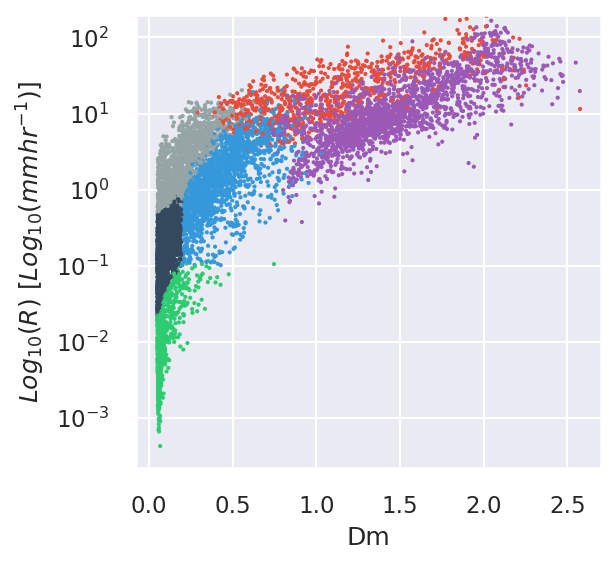

In [29]:
fig, ax = plt.subplots(figsize=(4, 4), dpi=150)
ax.scatter(df.dm, df.r, c=df['kmeans_6'], s=1, cmap=my_cmap6)
ax.set_xlabel("Dm")
ax.set_ylabel(r"$Log_{10}(R) \ [Log_{10}(mm hr^{-1})]$")
ax.set_yscale('log')
ax.set_ylim(0, 200)

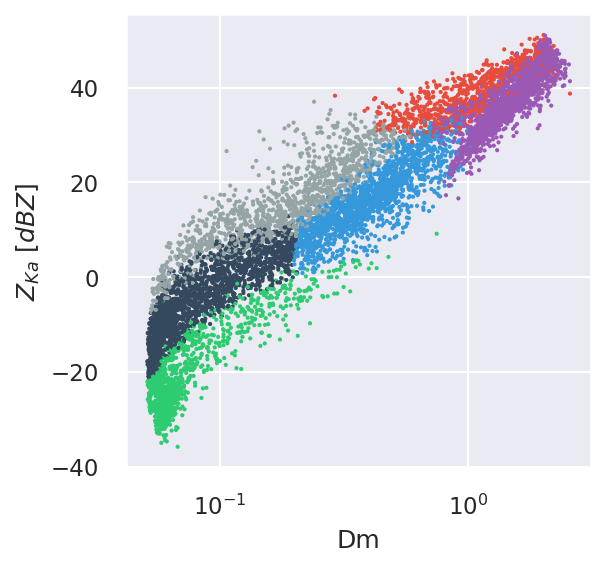

In [30]:
fig, ax = plt.subplots(figsize=(4, 4), dpi=150)
ax.scatter(df.dm, df.dbz_t_ka, c=df['kmeans_6'], s=1, cmap=my_cmap6)
ax.set_xlabel("Dm")
ax.set_ylabel(r"$Z_{Ka} \ [dBZ]$")
# ax.set_yscale('log')
ax.set_xscale('log')

# ax.set_ylim(0, 200)

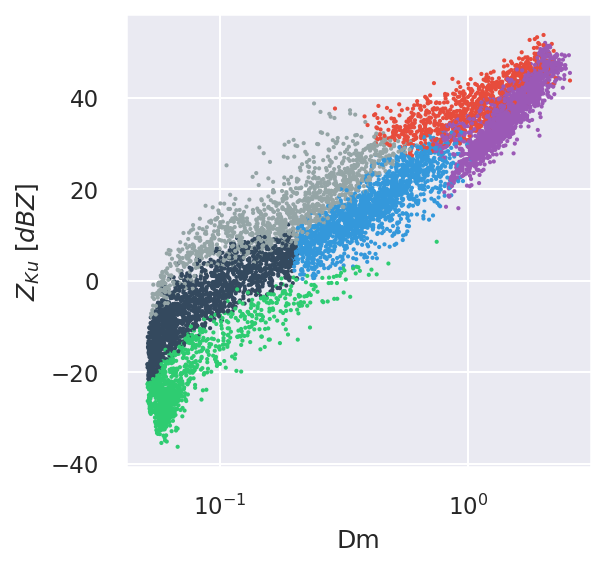

In [31]:
fig, ax = plt.subplots(figsize=(4, 4), dpi=150)
ax.scatter(df.dm, df.dbz_t_ku, c=df['kmeans_6'], s=1, cmap=my_cmap6)
ax.set_xlabel("Dm")
ax.set_ylabel(r"$Z_{Ku} \ [dBZ]$")
ax.set_xscale('log')
# ax.set_ylim(0, 200)

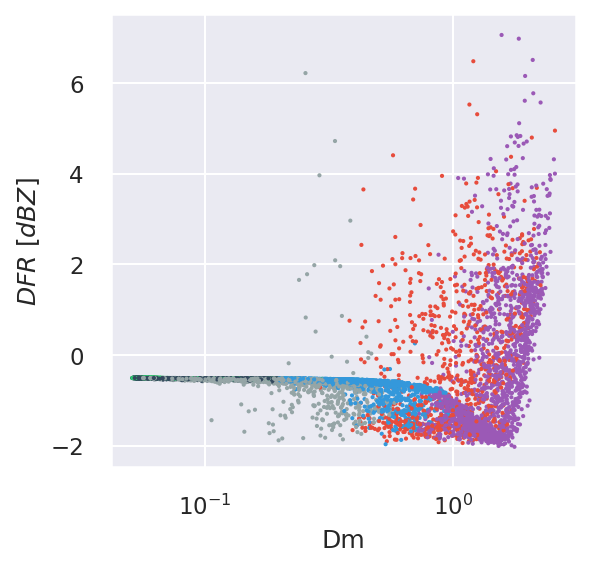

In [32]:
fig, ax = plt.subplots(figsize=(4, 4), dpi=150)
ax.scatter(df.dm, df.dbz_t_ku - df.dbz_t_ka, c=df['kmeans_6'], s=1, cmap=my_cmap6)
ax.set_xlabel("Dm")
ax.set_ylabel(r"$DFR \ [dBZ]$")
ax.set_xscale('log')
# ax.set_ylim(0, 200)

Text(0, 0.5, '$Log_{10}(Nt)$')

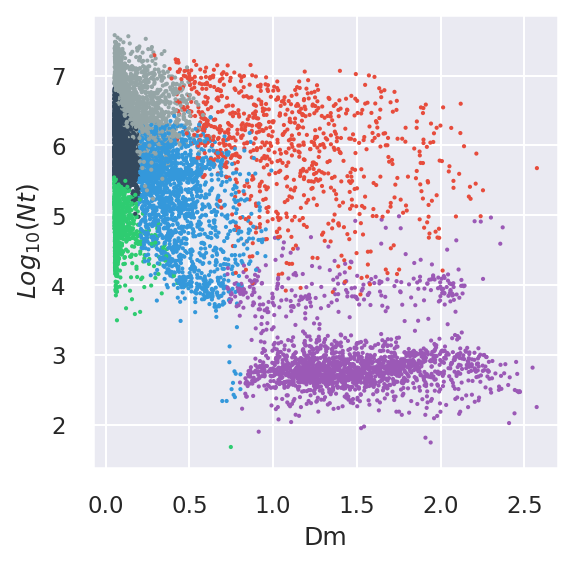

In [33]:
fig, ax = plt.subplots(figsize=(4, 4), dpi=150)
ax.scatter(df.dm, df.lognt, c=df['kmeans_6'], s=1, cmap=my_cmap6)
ax.set_xlabel("Dm")
ax.set_ylabel(r"$Log_{10}(Nt)$")
# ax.set_yscale('log')
# ax.set_ylim(0, 200)

(0.0, 10.0)

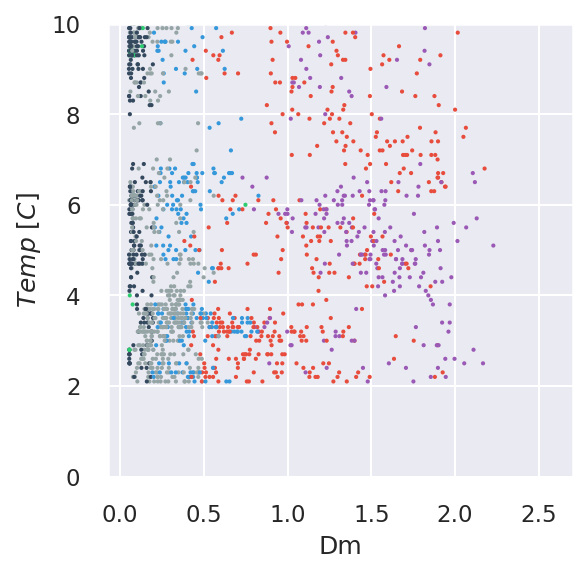

In [34]:
fig, ax = plt.subplots(figsize=(4, 4), dpi=150)
ax.scatter( df.dm, df.temp,c=df['kmeans_6'], s=1, cmap=my_cmap6)
ax.set_xlabel("Dm")
ax.set_ylabel(r"$Temp \ [C]$")
# ax.set_yscale('log')
ax.set_ylim(0, 10)

Text(0, 0.5, '$Temp \\ [C]$')

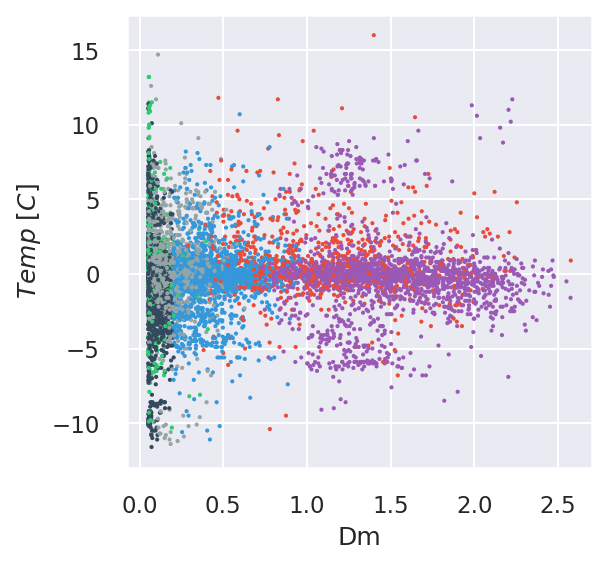

In [35]:
fig, ax = plt.subplots(figsize=(4, 4), dpi=150)
ax.scatter(df.dm, df.vert_vel, c=df['kmeans_6'], s=1, cmap=my_cmap6)
ax.set_xlabel("Dm")
ax.set_ylabel(r"$Temp \ [C]$")
# ax.set_yscale('log')
# ax.set_ylim(0, 10)

Text(0, 0.5, '$Altitude \\ [ft]$')

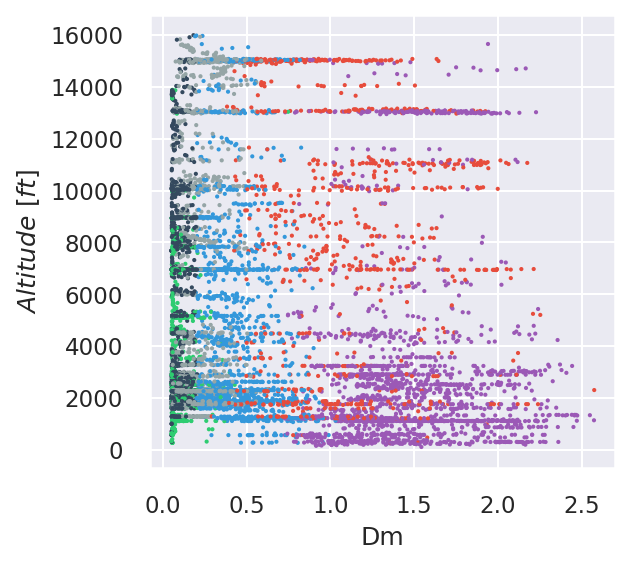

In [36]:
fig, ax = plt.subplots(figsize=(4, 4), dpi=150)
ax.scatter(df.dm, df.altitude, c=df['kmeans_6'], s=1, cmap=my_cmap6)
ax.set_xlabel("Dm")
ax.set_ylabel(r"$Altitude \ [ft]$")
# ax.set_yscale('log')
# ax.set_ylim(0, 10)

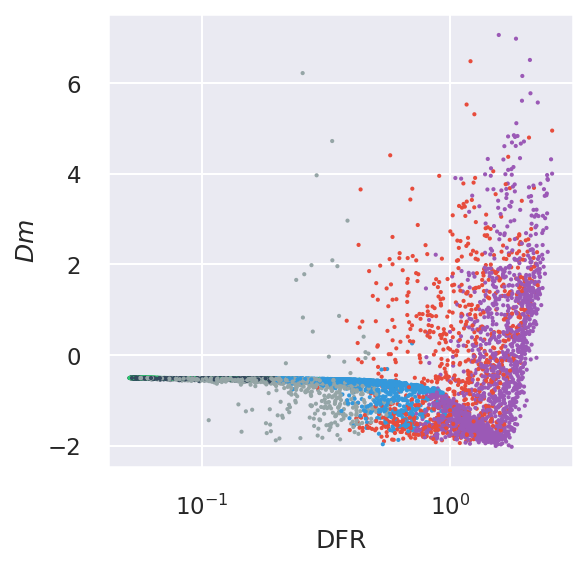

In [37]:
fig, ax = plt.subplots(figsize=(4, 4), dpi=150)
ax.scatter( df.dm, df.dfr, c=df['kmeans_6'], s=1, cmap=my_cmap6)
ax.set_xlabel("DFR")
ax.set_ylabel(r"$Dm$")
ax.set_xscale('log')
# ax.set_ylim(0, 10)

# Scores

In [38]:
def get_kmeans_score(df, center):
    '''
    returns the kmeans score regarding Davies Bouldin for points to centers
    INPUT:
        data - the dataset you want to fit kmeans to
        center - the number of centers you want (the k value)
    OUTPUT:
        score - the Davies Bouldin score for the kmeans model fit to the data
    '''
    kmeans = KMeans(n_clusters=center)
    model = kmeans.fit(df)
    model2 = kmeans.fit_predict(df)
    cluster_labels = model.labels_
    
    dav = davies_bouldin_score(df, model2)
    sil = silhouette_score(df, cluster_labels)
    elbow = model.inertia_
    return dav, sil, elbow

dav = []
sil = []
elbow = []


for center in range(2,15):
    _dav, _sil, _el = get_kmeans_score(df[['sigma_T', 'dm_T', 'log10_nw_T', 'logr_T', 'lognt_T', "loglwc_T"]], center)
    dav.append(_dav)
    sil.append(_sil)
    elbow.append(_el)


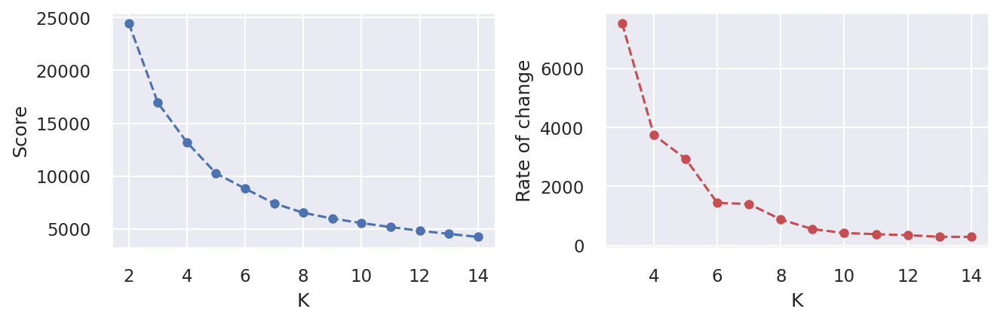

In [39]:
centers = range(2,15)
fig, (ax, ax1) = plt.subplots(1, 2, figsize=(9, 3), dpi=150)
ax.plot(centers, elbow, linestyle='--', marker='o', color='b');
ax.set_xlabel('K');
ax.set_ylabel('Score');
ax1.plot(centers[1:], np.array(elbow[:-1]) - np.array(elbow[1:]) , linestyle='--', marker='o', color='r');
# ax1.bar(centers[1:], height=np.array(elbow[:-1]) - np.array(elbow[1:]));

ax1.set_xlabel('K');
ax1.set_ylabel('Rate of change');
plt.tight_layout()

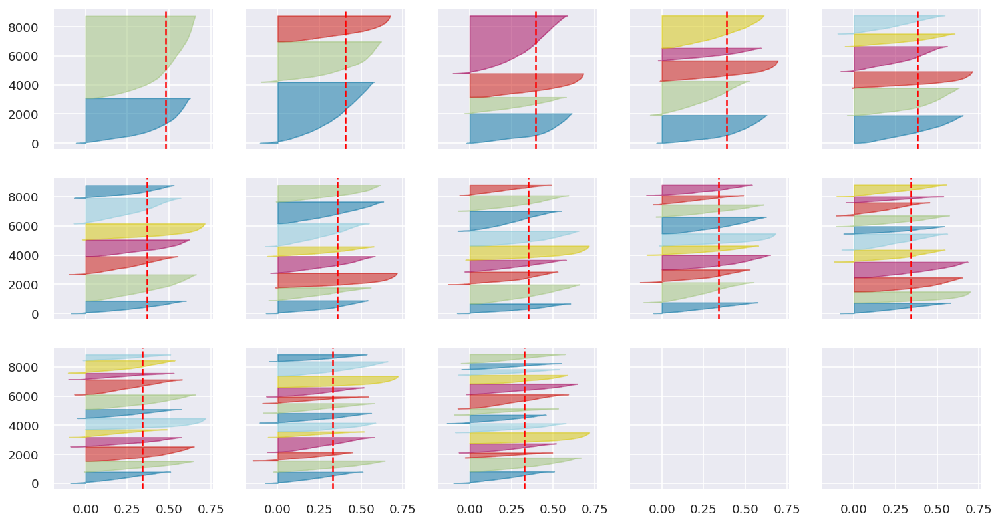

In [40]:
fig, axs = plt.subplots(3, 5, figsize=(15,8), sharex=True, sharey=True)
centers = np.arange(2, 15)
for idx, ax in enumerate(axs.flat):
    '''
    Create KMeans instance for different number of clusters
    '''
    try:
        km = KMeans(n_clusters=centers[idx]) # , init='k-means++', n_init=10, max_iter=100, random_state=42)
        '''
        Create SilhouetteVisualizer instance with KMeans instance
        Fit the visualizer
        '''
        visualizer = SilhouetteVisualizer(km, colors='yellowbrick', ax=ax)
        visualizer.fit(X)
    except IndexError:
        pass

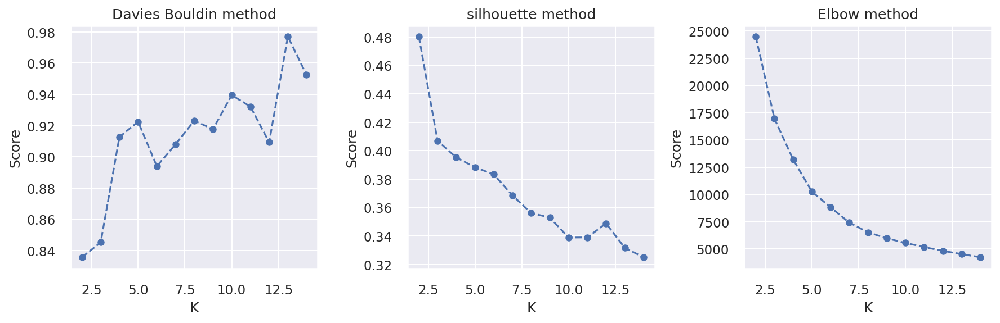

In [41]:
centers = range(2,15)
fig, (ax, ax1, ax2) = plt.subplots(1, 3, figsize=(12, 4), dpi=150)
ax.plot(centers, dav, linestyle='--', marker='o', color='b');
ax.set_xlabel('K');
ax.set_ylabel('Score');
ax.set_title('Davies Bouldin method');

ax1.plot(centers, sil, linestyle='--', marker='o', color='b');
ax1.set_xlabel('K');
ax1.set_ylabel('Score');
ax1.set_title('silhouette method');

ax2.plot(centers, elbow, linestyle='--', marker='o', color='b');
ax2.set_xlabel('K');
ax2.set_ylabel('Score');
ax2.set_title('Elbow method');
fig.tight_layout()

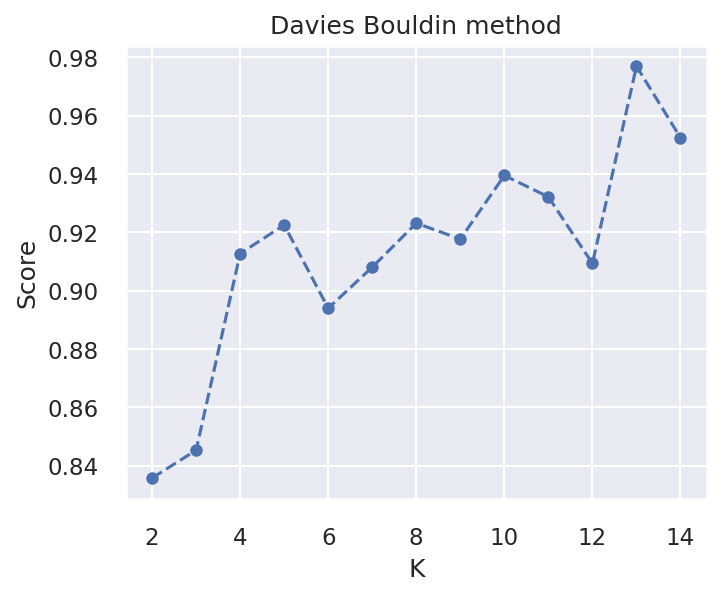

In [42]:
centers = range(2,15)
fig, ax = plt.subplots(figsize=(5, 4), dpi=150)
ax.plot(centers, dav, linestyle='--', marker='o', color='b');
ax.set_xlabel('K');
ax.set_ylabel('Score');
ax.set_title('Davies Bouldin method');

In [43]:
pca = PCA(0.90)
df[['PCA1', 'PCA2']] = pca.fit_transform(X)

In [44]:
g1 = df[(df.PCA1 > 1.5) & (df.PCA2 > -1.5)  & (df.PCA2 < 1.5)]
df.loc[(df.PCA1 > 1.5) & (df.PCA2 > -1.5)  & (df.PCA2 < 1.5), 'Group_PCA'] = 1
g2 = df[(df.PCA1 > -4.5) & (df.PCA1 < -1.5)]
df.loc[(df.PCA1 > -4.5) & (df.PCA1 < -1.5), 'Group_PCA'] = 2
g3 = df[(df.PCA2 > 1.5)& (df.PCA1 > -1.5) & (df.PCA1 < 1.5)]
df.loc[(df.PCA2 > 1.5)& (df.PCA1 > -1.5) & (df.PCA1 < 1.5), 'Group_PCA'] = 3
g4 = df[(df.PCA2 < -1.5)& (df.PCA1 > -1.5) & (df.PCA1 < 1.5)]
df.loc[(df.PCA2 < -1.5)& (df.PCA1 > -1.5) & (df.PCA1 < 1.5), 'Group_PCA'] = 4
g5 = df[(df.PCA2 > 1.5)& (df.PCA1 > 1.5)]
df.loc[(df.PCA2 > 1.5)& (df.PCA1 > 1.5), 'Group_PCA'] = 5
g6 = df[(df.PCA2 < -1.5)& (df.PCA1 > 1.5)]
df.loc[(df.PCA2 < -1.5)& (df.PCA1 > 1.5), 'Group_PCA'] = 6
gn = df[(df.PCA2 > -1.5) & (df.PCA2 < 1.5) & (df.PCA1 > -1.5) & (df.PCA1 < 1.5)]
df.loc[(df.PCA2 > -1.5) & (df.PCA2 < 1.5) & (df.PCA1 > -1.5) & (df.PCA1 < 1.5), 'Group_PCA'] = 7

In [45]:
ls_gr = [g1, g2, g3, g4, g5, g6]

In [46]:
d = ds.diameter / 1000
dm1, mu1, nw1 = g1['dm'].mean(), g1['mu'].mean(), 10 ** (g1['log10_nw']).mean()
gm1 = norm_gamma(d, nw=nw1, mu=mu1, dm=dm1)

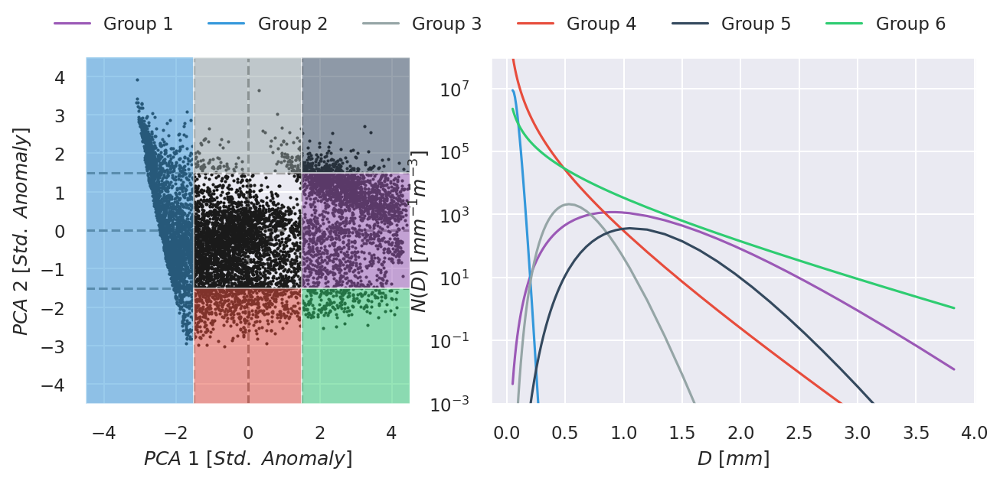

In [47]:
fig, (ax, ax1) = plt.subplots(1, 2, figsize=(10,4), dpi=150, gridspec_kw={'width_ratios': [1, 1.5]})
ax1.set_yscale('log')
ax1.set_ylim(1e-3, 1e8)
ax1.grid('both')
n = len(ls_gr)
ax1.set_ylabel("$N(D) \  [mm^{-1}m^{-3}]$", labelpad=-2)
ax1.set_xlabel("$D\ [mm]$")
for idx, i in enumerate(ls_gr):
    dm, mu, nw = i['dm'].mean(), i['mu'].mean(), 10 ** (i['log10_nw']).mean()
    gm = norm_gamma(d, nw=nw, mu=mu, dm=dm)
    ax1.plot(d, gm, c=colors6[idx], label=f"Group {idx + 1}")
# ax1.legend()

ax.scatter(df.PCA1, df.PCA2, s=1, zorder=10, c='k')
ax.axvline(x=0, ls="--", c='grey', lw=1.5)
ax.axvline(x=1.5, ls="--",  c='grey', lw=1.5)
ax.axvline(x=-1.5, ls="--",  c='grey', lw=1.5)
ax.axhline(y=0, ls="--",  c='grey', lw=1.5)
ax.axhline(y=1.5, ls="--",  c='grey', lw=1.5)
ax.axhline(y=-1.5, ls="--",  c='grey', lw=1.5)

# group 1
rect = plt.Rectangle((1.5,-1.5), 4.5, 3,
                     facecolor=colors6[0], alpha=0.5, zorder=10)
ax.add_patch(rect)

# group 2
rect5 = plt.Rectangle((-4.5, -4.5), 3, 10,
                     facecolor=colors6[1], alpha=0.5, zorder=10)
ax.add_patch(rect5)

# group 3
rect4 = plt.Rectangle((-1.5, 1.5), 3, 3,
                     facecolor=colors6[2], alpha=0.5, zorder=10)

ax.add_patch(rect4)

# group 4
rect3 = plt.Rectangle((-1.5,-4.5), 3, 3,
                     facecolor=colors6[3], alpha=0.5, zorder=10)
ax.add_patch(rect3)

# group 5
rect1 = plt.Rectangle((1.5,1.5), 3.5, 3,
                     facecolor=colors6[4], alpha=0.5, zorder=10)
ax.add_patch(rect1)

#group 6
rect2 = plt.Rectangle((1.5,-4.5), 3.5, 3,
                     facecolor=colors6[5], alpha=0.5, zorder=10)
ax.add_patch(rect2)

ax.set_xlabel(r"$PCA \ 1 \ [Std. \ Anomaly]$")
ax.set_ylabel(r"$PCA \ 2 \ [Std. \ Anomaly]$")
ax.set_ylim(-4.5, 4.5)
ax.set_xlim(-4.5, 4.5)
lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels, loc='upper center', ncol=6)
# fig.tight_layout()

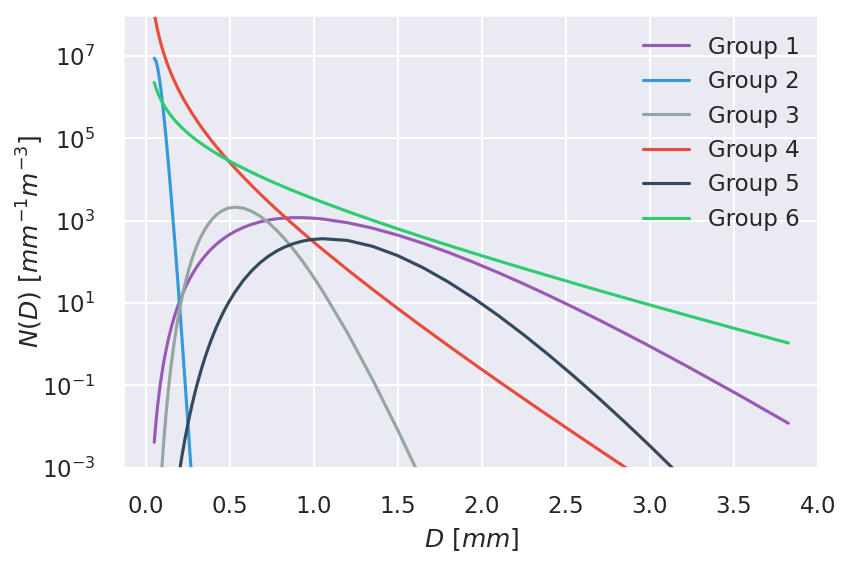

In [48]:
fig, ax1 = plt.subplots(figsize=(6,4), dpi=150)
ax1.set_yscale('log')
ax1.set_ylim(1e-3, 1e8)
ax1.grid('both')
n = len(ls_gr)
ax1.set_ylabel("$N(D) \  [mm^{-1}m^{-3}]$", labelpad=-2)
ax1.set_xlabel("$D\ [mm]$")
for idx, i in enumerate(ls_gr):
    dm, mu, nw = i['dm'].mean(), i['mu'].mean(), 10 ** (i['log10_nw']).mean()
    gm = norm_gamma(d, nw=nw, mu=mu, dm=dm)
    ax1.plot(d, gm, c=colors6[idx], label=f"Group {idx + 1}")
ax1.legend()

In [49]:
from matplotlib.colors import ListedColormap

# construct cmap
flatui = ["#9b59b6", "#3498db", "#95a5a6", "#e74c3c", "#34495e", "#2ecc71", "#FFFF00"]
my_cmap7 = ListedColormap(sns.color_palette(flatui).as_hex())
n=7
colors7 = my_cmap7(np.linspace(0,1,n))

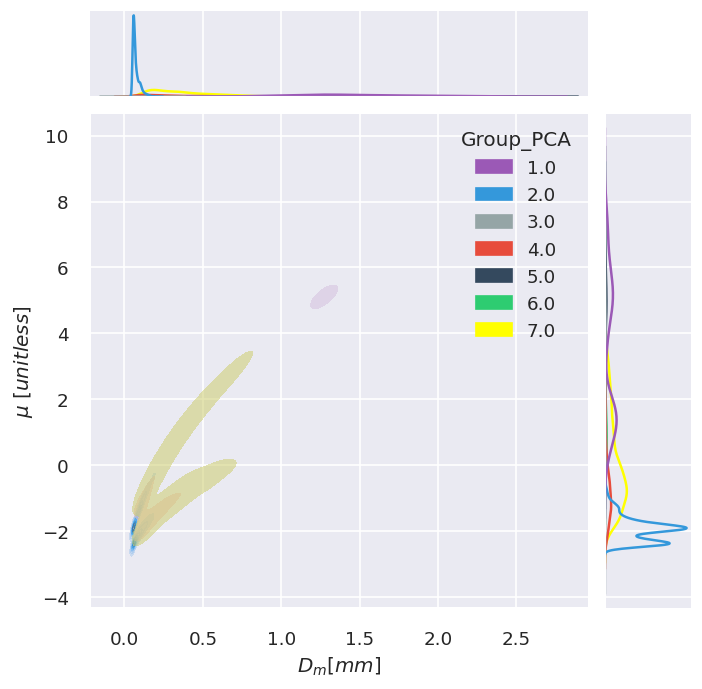

In [50]:
labels = ['1', '2', '3', '4', '5', '6', "7"]
p = sns.jointplot(data=df, 
                  x="dm", y="new_mu", kind="kde", hue="Group_PCA", palette=sns.color_palette(flatui).as_hex(), 
                  shade=True, alpha=.5,)
p.fig.subplots_adjust(top=0.95)
p.set_axis_labels(r"${D_m [mm]}$", r"${\mu \  [unitless]}$",)
# p.ax_marg_y.set_ylim(-75, 75)
# p._legend.remove()
ax = plt.gca()
plt.show()

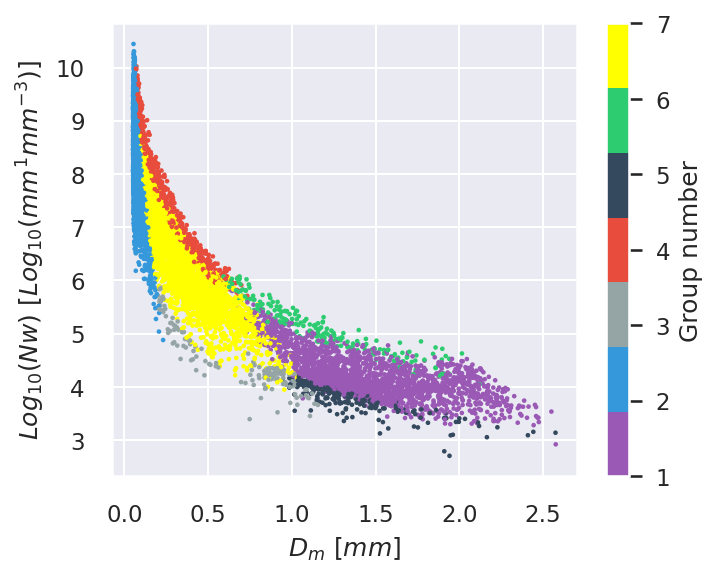

In [51]:
fig,  ax = plt.subplots(figsize=(5,4), dpi=150)
sc = ax.scatter(df['dm'], df['log10_nw'], c=df["Group_PCA"], s=1.5, cmap=my_cmap7)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")



In [52]:
from sklearn.cluster import Birch, DBSCAN, MiniBatchKMeans, MeanShift, OPTICS, SpectralClustering

In [53]:
model = Birch(threshold=0.01, n_clusters=6)
model.fit(X)

Birch(n_clusters=6, threshold=0.01)

In [54]:
df['birch_g'] = model.predict(X)

In [55]:
silhouette_score(X, df['birch_g'])

0.3219449648273194

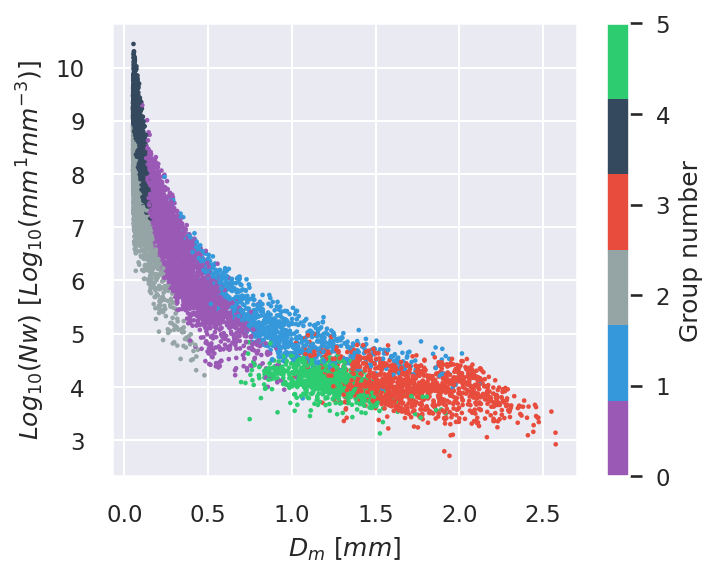

In [56]:
fig,  ax = plt.subplots(figsize=(5,4), dpi=150)
sc = ax.scatter(df['dm'], df['log10_nw'], c=df["birch_g"], s=1.5, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")


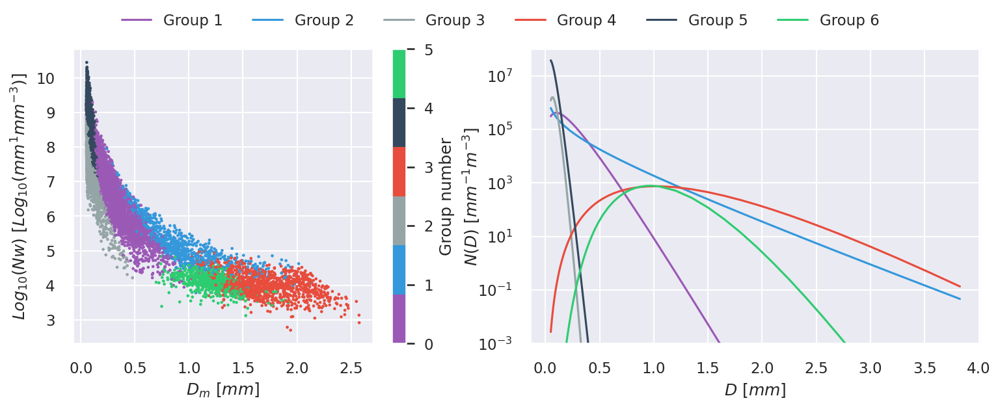

In [57]:
fig, (ax, ax1) = plt.subplots(1, 2, figsize=(12,4), dpi=150,  gridspec_kw={'width_ratios': [1, 1.2]})
sc = ax.scatter(df['dm'], df['log10_nw'], c=df['birch_g'], s=1.5, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")

ax1.set_yscale('log')
ax1.set_ylim(1e-3, 1e8)
d = ds.diameter/1000
ax1.grid('both')
n = df['kmeans_6'].max() + 1
ax1.set_ylabel("$N(D) \  [mm^{-1}m^{-3}]$", labelpad=-3)
ax1.set_xlabel("$D\ [mm]$")
# colors = pl.cm.jet(np.linspace(0,1,n))
for i in range(0,n):
    df_sub = df[df['birch_g'] == i]
    mu = df_sub['mu'].mean()
    dm = df_sub['dm'].mean()
    nw = 10 ** (df_sub['log10_nw'].mean())
    gm = norm_gamma(d, nw=nw, mu=mu, dm=dm)
    ax1.plot(ds.diameter/1000, gm, c=colors6[i], label=f"Group {i + 1}")
# ax1.legend()

lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels, loc='upper center', ncol=6)

In [58]:
model = DBSCAN(eps=0.30, min_samples=500)
# fit model and predict clusters
df['dbscan_g'] = model.fit_predict(X)

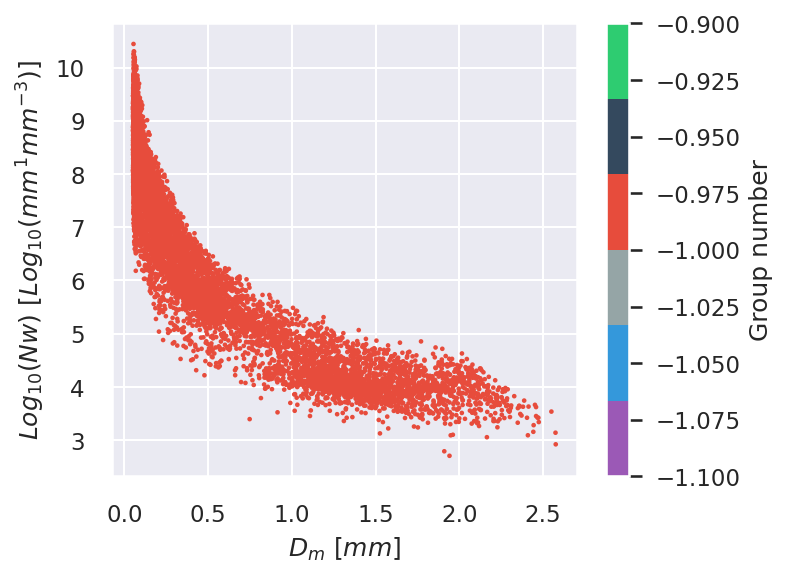

In [59]:
fig,  ax = plt.subplots(figsize=(5,4), dpi=150)
sc = ax.scatter(df['dm'], df['log10_nw'], c=df["dbscan_g"], s=1.5, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")

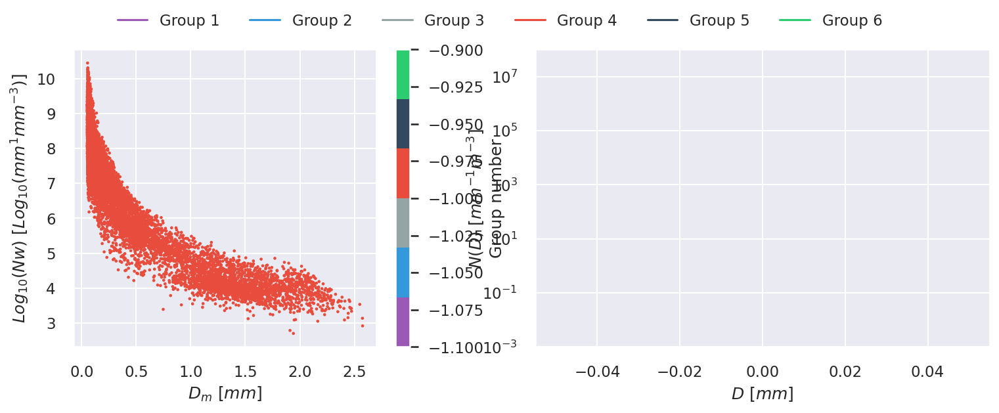

In [60]:
fig, (ax, ax1) = plt.subplots(1, 2, figsize=(12,4), dpi=150,  gridspec_kw={'width_ratios': [1, 1.2]})
sc = ax.scatter(df['dm'], df['log10_nw'], c=df['dbscan_g'], s=1.5, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")

ax1.set_yscale('log')
ax1.set_ylim(1e-3, 1e8)
d = ds.diameter/1000
ax1.grid('both')
n = df['kmeans_6'].max() + 1
ax1.set_ylabel("$N(D) \  [mm^{-1}m^{-3}]$", labelpad=-3)
ax1.set_xlabel("$D\ [mm]$")
# colors = pl.cm.jet(np.linspace(0,1,n))
for i in range(0,n):
    df_sub = df[df['dbscan_g'] == i]
    mu = df_sub['mu'].mean()
    dm = df_sub['dm'].mean()
    nw = 10 ** (df_sub['log10_nw'].mean())
    gm = norm_gamma(d, nw=nw, mu=mu, dm=dm)
    ax1.plot(ds.diameter/1000, gm, c=colors6[i], label=f"Group {i + 1}")
# ax1.legend()

lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels, loc='upper center', ncol=6)

In [61]:
model = MiniBatchKMeans(n_clusters=6)
# fit the model
model.fit(X)
df['Mb_kmeans'] = model.predict(X)

In [62]:
davies_bouldin_score(X, df['Mb_kmeans'])
silhouette_score(X, df['Mb_kmeans'])

0.37101963324298737

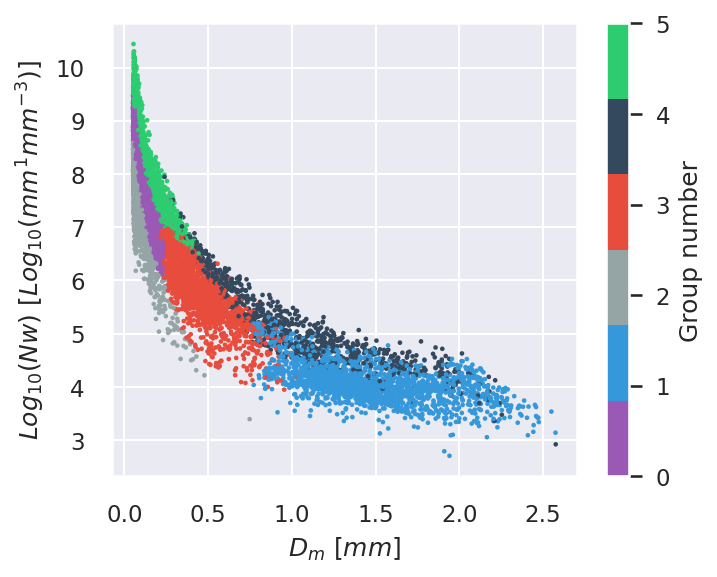

In [63]:
fig,  ax = plt.subplots(figsize=(5,4), dpi=150)
sc = ax.scatter(df['dm'], df['log10_nw'], c=df["Mb_kmeans"], s=1.5, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")

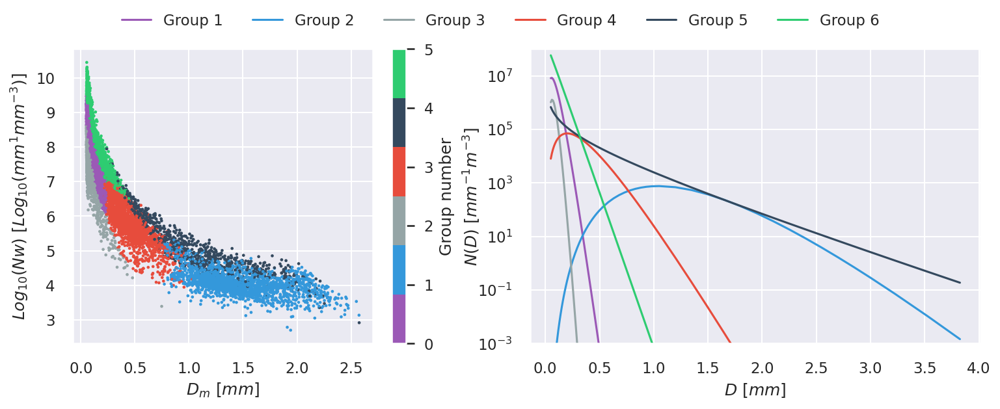

In [64]:
fig, (ax, ax1) = plt.subplots(1, 2, figsize=(12,4), dpi=150,  gridspec_kw={'width_ratios': [1, 1.2]})
sc = ax.scatter(df['dm'], df['log10_nw'], c=df['Mb_kmeans'], s=1.5, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")

ax1.set_yscale('log')
ax1.set_ylim(1e-3, 1e8)
d = ds.diameter/1000
ax1.grid('both')
n = df['kmeans_6'].max() + 1
ax1.set_ylabel("$N(D) \  [mm^{-1}m^{-3}]$", labelpad=-3)
ax1.set_xlabel("$D\ [mm]$")
# colors = pl.cm.jet(np.linspace(0,1,n))
for i in range(0,n):
    df_sub = df[df['Mb_kmeans'] == i]
    mu = df_sub['mu'].mean()
    dm = df_sub['dm'].mean()
    nw = 10 ** (df_sub['log10_nw'].mean())
    gm = norm_gamma(d, nw=nw, mu=mu, dm=dm)
    ax1.plot(ds.diameter/1000, gm, c=colors6[i], label=f"Group {i + 1}")
# ax1.legend()

lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels, loc='upper center', ncol=6)

In [65]:
model = MeanShift()
# fit model and predict clusters
df['mean_shift'] = model.fit_predict(X)

In [66]:
davies_bouldin_score(X, df['mean_shift'])

0.8337952526332633

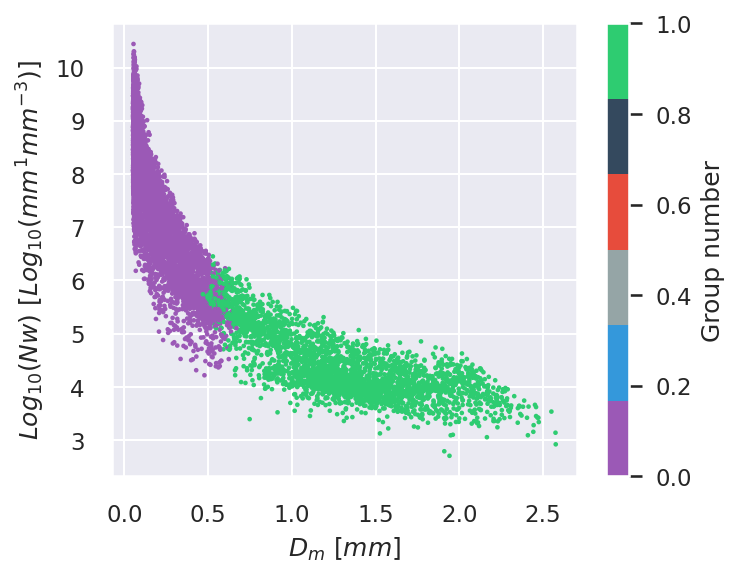

In [67]:
fig,  ax = plt.subplots(figsize=(5,4), dpi=150)
sc = ax.scatter(df['dm'], df['log10_nw'], c=df["mean_shift"], s=1.5, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")

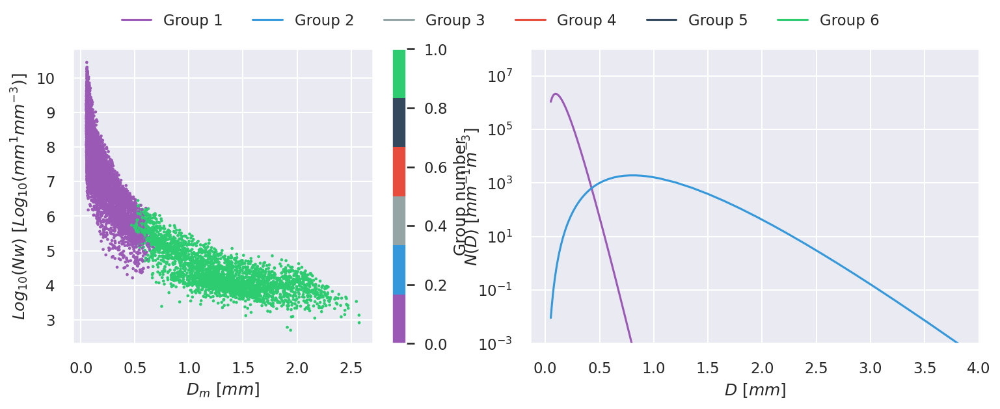

In [68]:
fig, (ax, ax1) = plt.subplots(1, 2, figsize=(12,4), dpi=150,  gridspec_kw={'width_ratios': [1, 1.2]})
sc = ax.scatter(df['dm'], df['log10_nw'], c=df['mean_shift'], s=1.5, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")

ax1.set_yscale('log')
ax1.set_ylim(1e-3, 1e8)
d = ds.diameter/1000
ax1.grid('both')
n = df['kmeans_6'].max() + 1
ax1.set_ylabel("$N(D) \  [mm^{-1}m^{-3}]$", labelpad=-3)
ax1.set_xlabel("$D\ [mm]$")
# colors = pl.cm.jet(np.linspace(0,1,n))
for i in range(0,n):
    df_sub = df[df['mean_shift'] == i]
    mu = df_sub['mu'].mean()
    dm = df_sub['dm'].mean()
    nw = 10 ** (df_sub['log10_nw'].mean())
    gm = norm_gamma(d, nw=nw, mu=mu, dm=dm)
    ax1.plot(ds.diameter/1000, gm, c=colors6[i], label=f"Group {i + 1}")
# ax1.legend()

lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels, loc='upper center', ncol=6)

In [69]:
model = OPTICS(eps=0.8, min_samples=10)
# fit model and predict clusters
df['optics']= model.fit_predict(X)

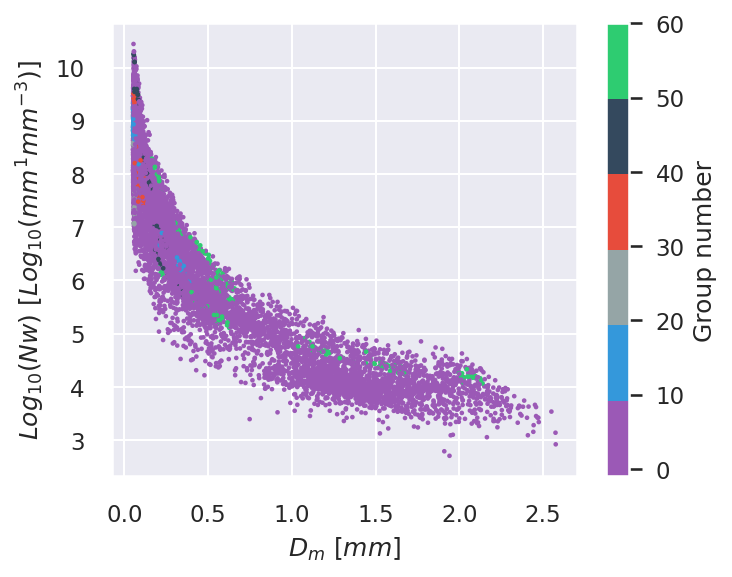

In [70]:
fig,  ax = plt.subplots(figsize=(5,4), dpi=150)
sc = ax.scatter(df['dm'], df['log10_nw'], c=df["optics"], s=1.5, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")

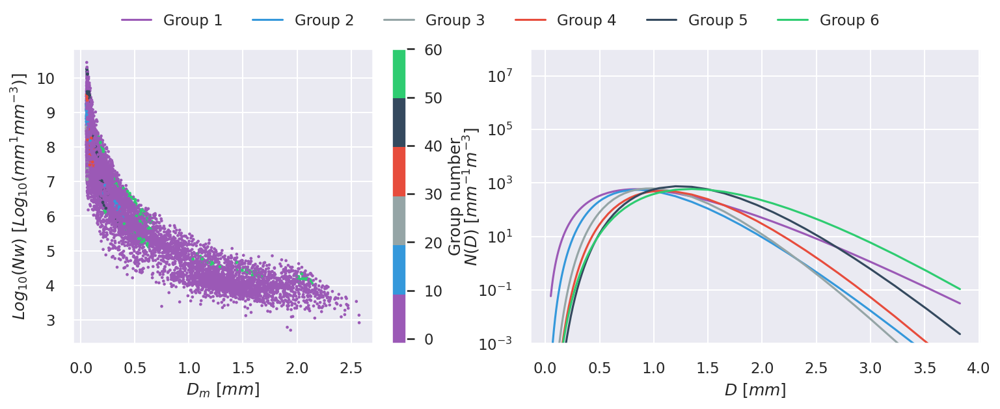

In [71]:
fig, (ax, ax1) = plt.subplots(1, 2, figsize=(12,4), dpi=150,  gridspec_kw={'width_ratios': [1, 1.2]})
sc = ax.scatter(df['dm'], df['log10_nw'], c=df['optics'], s=1.5, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")

ax1.set_yscale('log')
ax1.set_ylim(1e-3, 1e8)
d = ds.diameter/1000
ax1.grid('both')
n = df['optics'].max() + 1
ax1.set_ylabel("$N(D) \  [mm^{-1}m^{-3}]$", labelpad=-3)
ax1.set_xlabel("$D\ [mm]$")
# colors = pl.cm.jet(np.linspace(0,1,n))
for i in range(0,n):
    try:
        df_sub = df[df['optics'] == i]
        mu = df_sub['mu'].mean()
        dm = df_sub['dm'].mean()
        nw = 10 ** (df_sub['log10_nw'].mean())
        gm = norm_gamma(d, nw=nw, mu=mu, dm=dm)
        ax1.plot(ds.diameter/1000, gm, c=colors6[i], label=f"Group {i + 1}")
    except IndexError:
        pass
# ax1.legend()

lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels, loc='upper center', ncol=6)

In [72]:
model = SpectralClustering(n_clusters=6)
# fit model and predict clusters
df['spectral'] = model.fit_predict(X)
# retrieve unique clusters


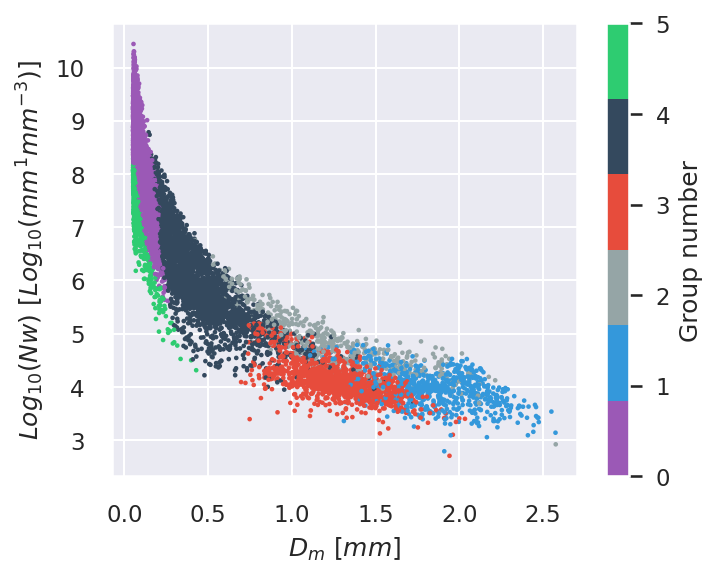

In [73]:
fig,  ax = plt.subplots(figsize=(5,4), dpi=150)
sc = ax.scatter(df['dm'], df['log10_nw'], c=df["spectral"], s=1.5, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")

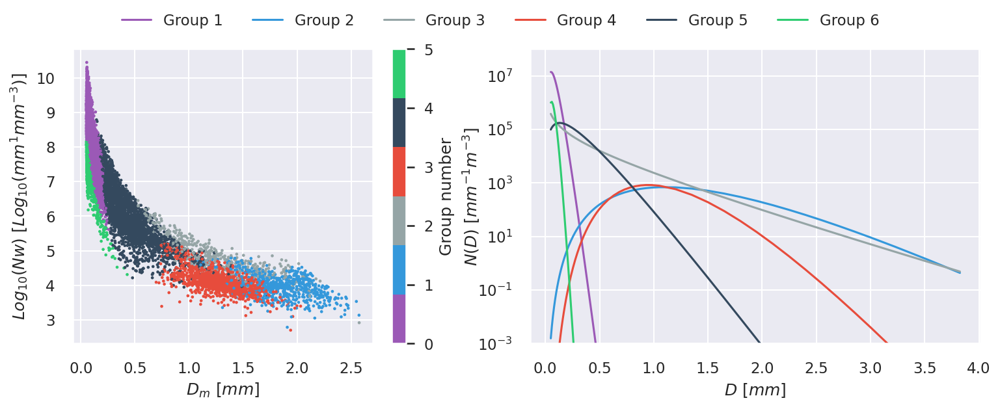

In [74]:
fig, (ax, ax1) = plt.subplots(1, 2, figsize=(12,4), dpi=150,  gridspec_kw={'width_ratios': [1, 1.2]})
sc = ax.scatter(df['dm'], df['log10_nw'], c=df['spectral'], s=1.5, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")

ax1.set_yscale('log')
ax1.set_ylim(1e-3, 1e8)
d = ds.diameter/1000
ax1.grid('both')
n = df['spectral'].max() + 1
ax1.set_ylabel("$N(D) \  [mm^{-1}m^{-3}]$", labelpad=-3)
ax1.set_xlabel("$D\ [mm]$")
# colors = pl.cm.jet(np.linspace(0,1,n))
for i in range(0,n):
    df_sub = df[df['spectral'] == i]
    mu = df_sub['mu'].mean()
    dm = df_sub['dm'].mean()
    nw = 10 ** (df_sub['log10_nw'].mean())
    gm = norm_gamma(d, nw=nw, mu=mu, dm=dm)
    ax1.plot(ds.diameter/1000, gm, c=colors6[i], label=f"Group {i + 1}")
# ax1.legend()

lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels, loc='upper center', ncol=6)

In [75]:
from sklearn.mixture import GaussianMixture

In [76]:
model = GaussianMixture(n_components=6)
# fit the model
model.fit(X)
# assign a cluster to each example
df['gaussian'] = model.predict(X)

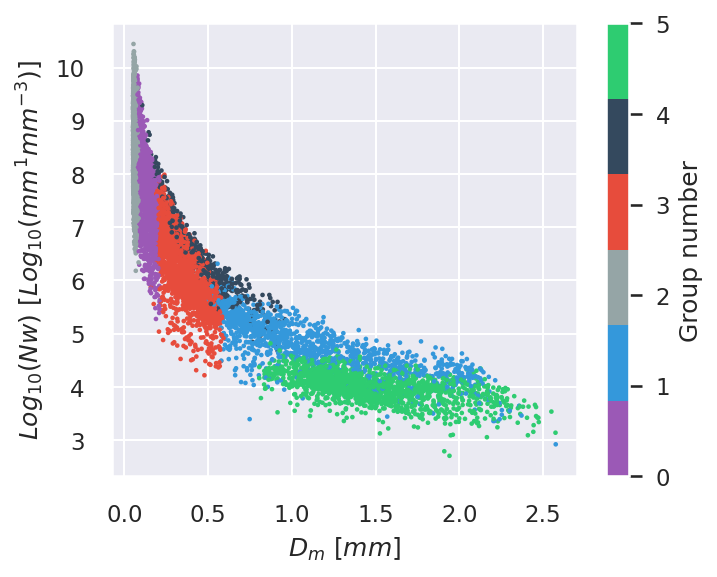

In [77]:
fig,  ax = plt.subplots(figsize=(5,4), dpi=150)
sc = ax.scatter(df['dm'], df['log10_nw'], c=df["gaussian"], s=1.5, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")

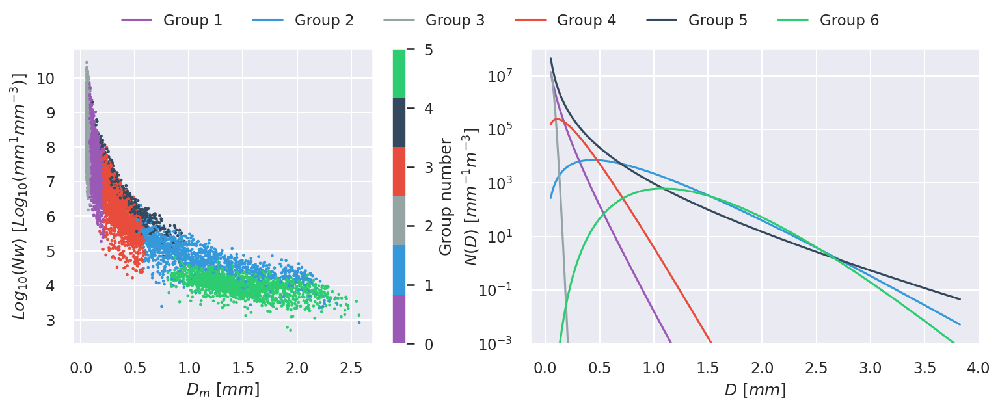

In [78]:
fig, (ax, ax1) = plt.subplots(1, 2, figsize=(12,4), dpi=150,  gridspec_kw={'width_ratios': [1, 1.2]})
sc = ax.scatter(df['dm'], df['log10_nw'], c=df['gaussian'], s=1.5, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")

ax1.set_yscale('log')
ax1.set_ylim(1e-3, 1e8)
d = ds.diameter/1000
ax1.grid('both')
n = df['gaussian'].max() + 1
ax1.set_ylabel("$N(D) \  [mm^{-1}m^{-3}]$", labelpad=-3)
ax1.set_xlabel("$D\ [mm]$")
# colors = pl.cm.jet(np.linspace(0,1,n))
for i in range(0,n):
    df_sub = df[df['gaussian'] == i]
    mu = df_sub['mu'].mean()
    dm = df_sub['dm'].mean()
    nw = 10 ** (df_sub['log10_nw'].mean())
    gm = norm_gamma(d, nw=nw, mu=mu, dm=dm)
    ax1.plot(ds.diameter/1000, gm, c=colors6[i], label=f"Group {i + 1}")
# ax1.legend()

lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels, loc='upper center', ncol=6)

In [79]:
model = AgglomerativeClustering(n_clusters=6).fit(X)
df['agg_clus'] = model.labels_

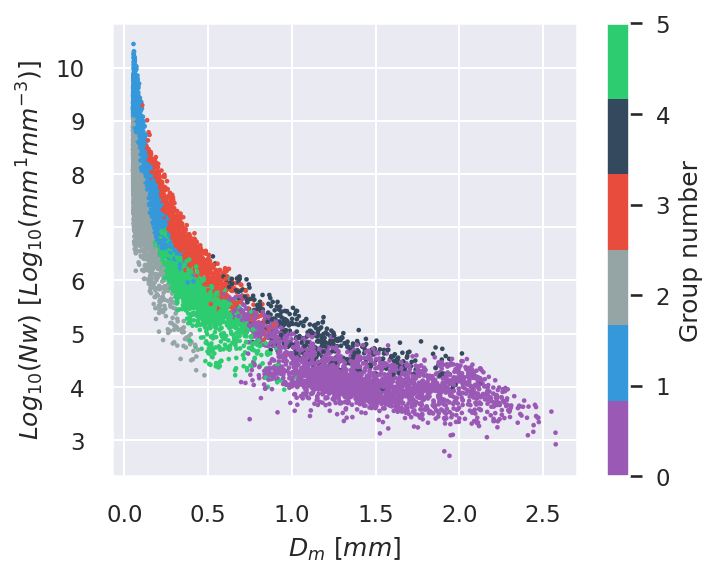

In [80]:
fig,  ax = plt.subplots(figsize=(5,4), dpi=150)
sc = ax.scatter(df['dm'], df['log10_nw'], c=df["agg_clus"], s=1.5, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")

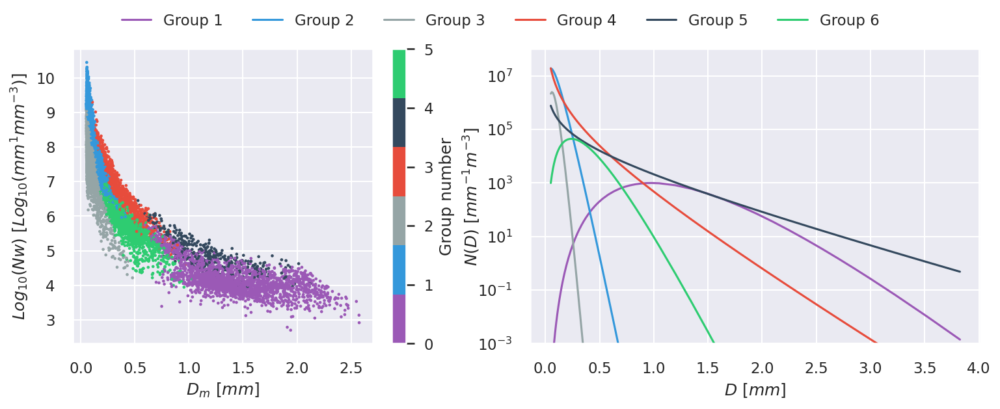

In [81]:
fig, (ax, ax1) = plt.subplots(1, 2, figsize=(12,4), dpi=150,  gridspec_kw={'width_ratios': [1, 1.2]})
sc = ax.scatter(df['dm'], df['log10_nw'], c=df['agg_clus'], s=1.5, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")

ax1.set_yscale('log')
ax1.set_ylim(1e-3, 1e8)
d = ds.diameter/1000
ax1.grid('both')
n = df['agg_clus'].max() + 1
ax1.set_ylabel("$N(D) \  [mm^{-1}m^{-3}]$", labelpad=-3)
ax1.set_xlabel("$D\ [mm]$")
# colors = pl.cm.jet(np.linspace(0,1,n))
for i in range(0,n):
    df_sub = df[df['agg_clus'] == i]
    mu = df_sub['mu'].mean()
    dm = df_sub['dm'].mean()
    nw = 10 ** (df_sub['log10_nw'].mean())
    gm = norm_gamma(d, nw=nw, mu=mu, dm=dm)
    ax1.plot(ds.diameter/1000, gm, c=colors6[i], label=f"Group {i + 1}")
# ax1.legend()

lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels, loc='upper center', ncol=6)

In [82]:
from sklearn.manifold import TSNE

In [83]:
tsne = TSNE(n_components=3, random_state=42)
df[['TSNE1', 'TSNE2', "TSNE3"]] = tsne.fit_transform(X)
tsne.kl_divergence_

0.8628531098365784

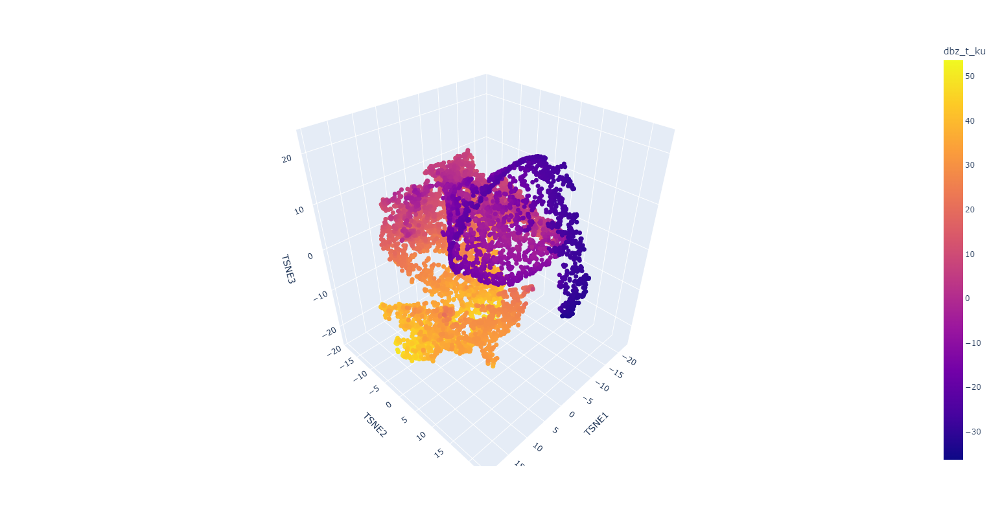

In [84]:
import plotly.express as px
fig = px.scatter_3d(df, x='TSNE1', y='TSNE2', z='TSNE3', color='dbz_t_ku',
             width=800, height=800)
fig.update_traces(marker_size = 4)
fig.show()

In [85]:
tsne = TSNE(n_components=2, random_state=42)
df[['tsne1', 'tsne2']] = tsne.fit_transform(X)
tsne.kl_divergence_

0.9695454239845276

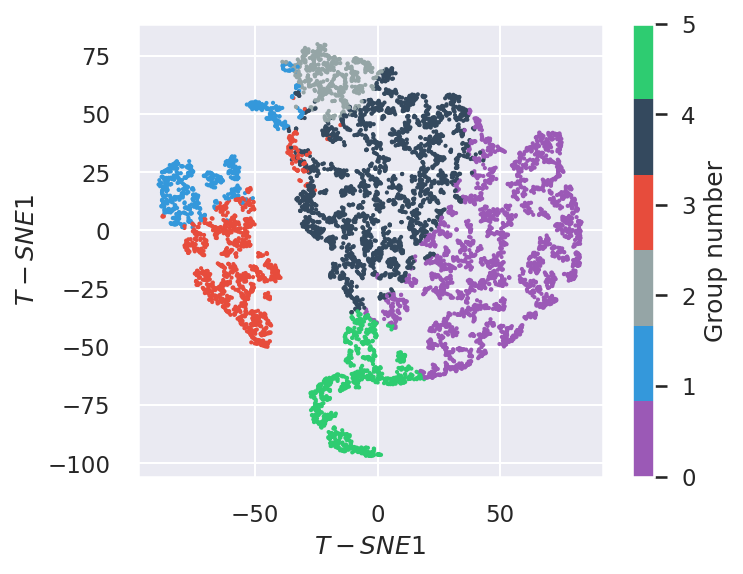

In [86]:

fig,  ax = plt.subplots(figsize=(5,4), dpi=150)
sc = ax.scatter(df['tsne1'], df['tsne2'], c=df['spectral'], s=1, cmap=my_cmap6)
ax.set_xlabel("$T-SNE1$")
ax.set_ylabel("$T-SNE1$")
fig.colorbar(sc, ax=ax, label="Group number")

In [87]:
pca = PCA(0.95)
df[['pca1', 'pca2', "pca3"]]  = pca.fit_transform(X)

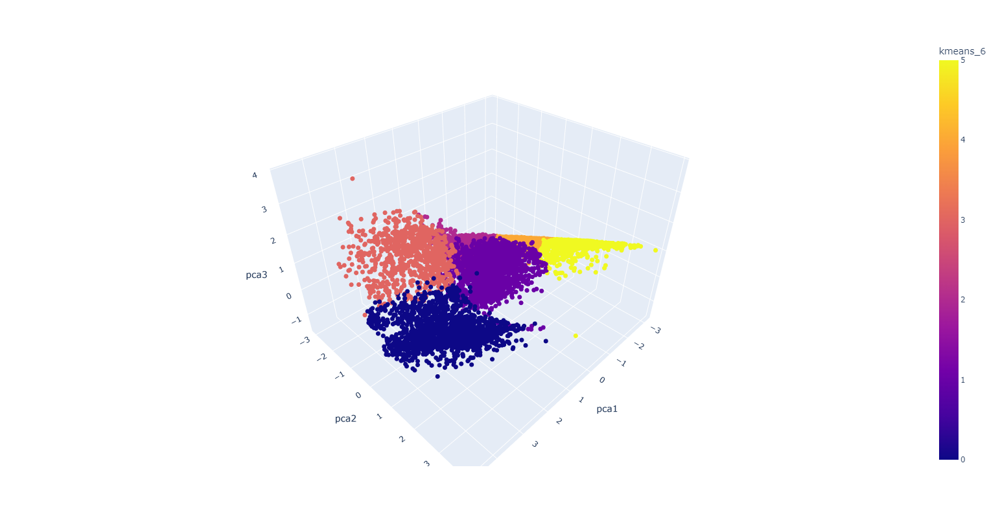

In [88]:
import plotly.express as px
fig = px.scatter_3d(df, x='pca1', y='pca2', z='pca3',
              color='kmeans_6', width=800, height=800, color_discrete_map=my_cmap6)
fig.update_traces(marker_size = 4)
fig.show()

In [89]:
from sklearn.cluster import AgglomerativeClustering

In [90]:
import umap

2023-06-02 10:20:15.757618: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [91]:
reducer = umap.UMAP(n_neighbors=50, min_dist=0.1, n_components=2, metric='euclidean')
df[["UM1", "UM2"]] = reducer.fit_transform(X)

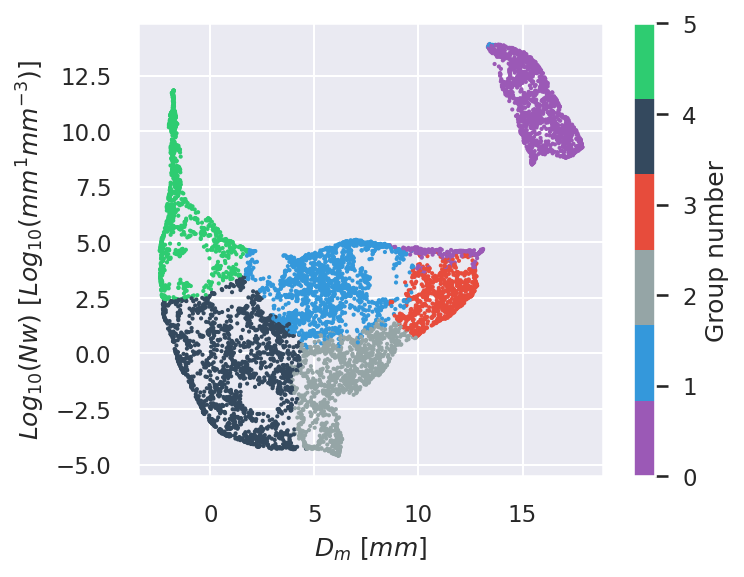

In [92]:
fig,  ax = plt.subplots(figsize=(5,4), dpi=150)
sc = ax.scatter(df['UM1'], df['UM2'], c=df['kmeans_6'], s=1, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")

In [93]:
reducer = umap.UMAP(n_neighbors=50, min_dist=0.1, n_components=3, metric='euclidean')
df[["UM1", "UM2", "UM3"]] = reducer.fit_transform(X)

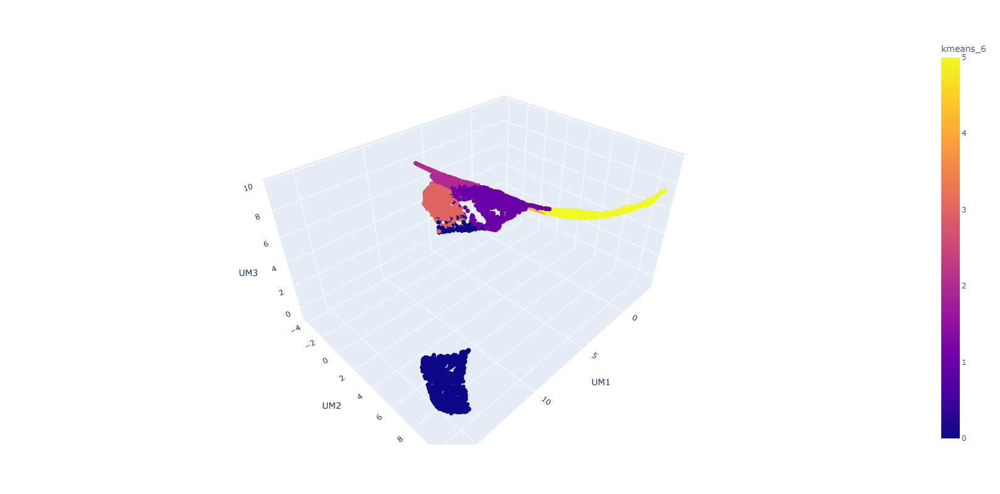

In [94]:
fig = px.scatter_3d(df, x='UM1', y='UM2', z='UM3',
              color='kmeans_6', width=800, height=800, color_discrete_map=my_cmap6)
fig.update_traces(marker_size = 4)
fig.show()

In [95]:
from sklearn import manifold

iso = manifold.Isomap(n_neighbors=6, n_components=2)
iso.fit(X)
df[["ISO1", "ISO2"]] = iso.transform(X)

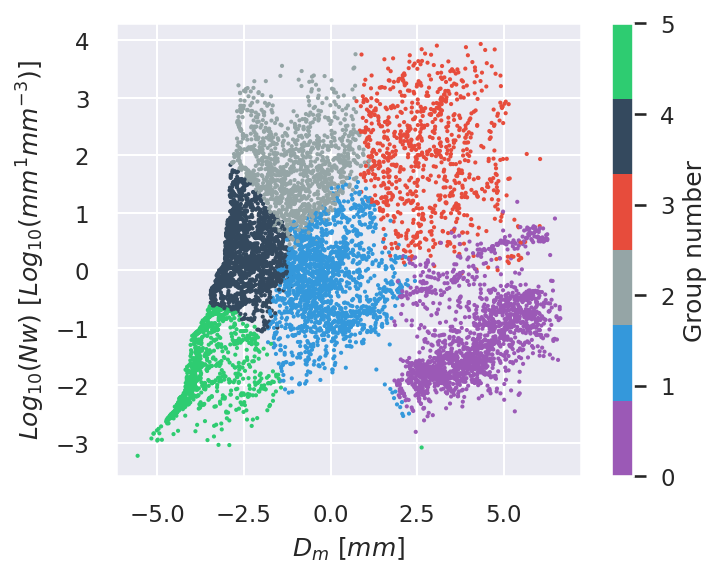

In [96]:
fig,  ax = plt.subplots(figsize=(5,4), dpi=150)
sc = ax.scatter(df['ISO1'], df['ISO2'], c=df['kmeans_6'], s=1, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")

In [97]:
iso = manifold.Isomap(n_neighbors=12, n_components=3)
iso.fit(X)
df[["ISO1", "ISO2", "ISO3"]] = iso.transform(X)

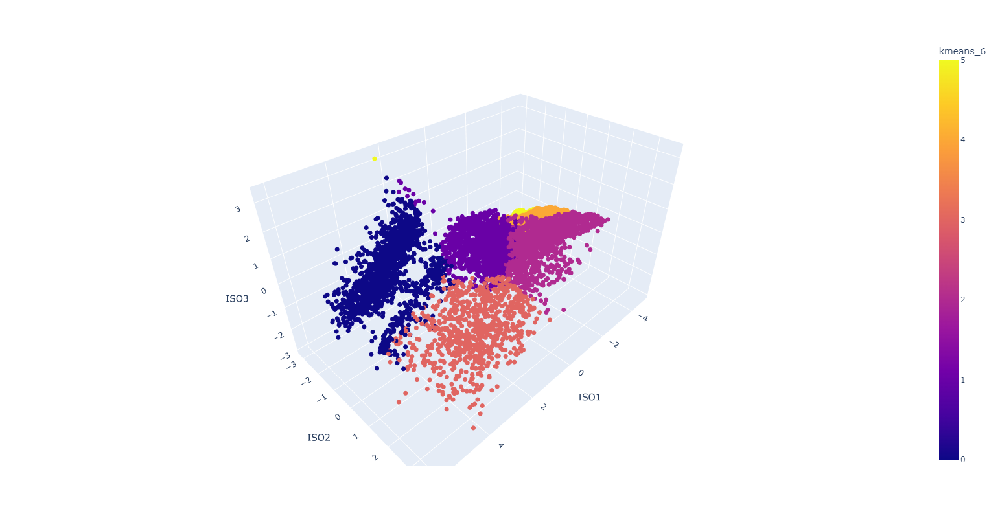

In [98]:
fig = px.scatter_3d(df, x='ISO1', y='ISO2', z='ISO3',
              color='kmeans_6', width=800, height=800, color_discrete_map=my_cmap6)
fig.update_traces(marker_size = 4)
fig.show()

In [99]:
n_c = 6
kmeans = KMeans(n_clusters=n_c)
kmeans.fit(df[["ISO1", "ISO2", "ISO3"]])
df['kmeans_iso'] = kmeans.labels_

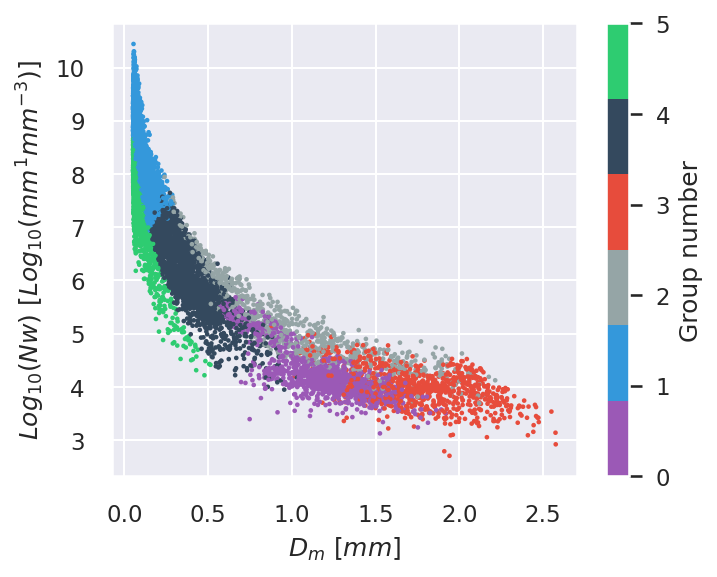

In [100]:
fig,  ax = plt.subplots(figsize=(5,4), dpi=150)
sc = ax.scatter(df['dm'], df['log10_nw'], c=df['kmeans_iso'], s=1.5, cmap=my_cmap6)
ax.set_xlabel("$D_m \ [mm]$")
ax.set_ylabel("$Log_{10}(Nw) \ [Log_{10}(mm^{1}mm^{-3})]$")
fig.colorbar(sc, ax=ax, label="Group number")

In [101]:
df.columns

Index(['time', 'sigma', 'sigmap', 'dm', 'log10_nw', 'mu', 'r', 'dfr',
       'dbz_t_ka', 'dbz_t_ku', 'nt', 'lwc_cum', 'temp', 'vert_vel', 'altitude',
       'new_mu', 'logr', 'lognt', 'loglwc', 'sigma_T', 'dm_T', 'log10_nw_T',
       'logr_T', 'lognt_T', 'loglwc_T', 'kmeans_6', 'mu_dm', 'mu_camp2ex',
       'mu_williams', 'PCA1', 'PCA2', 'Group_PCA', 'birch_g', 'dbscan_g',
       'Mb_kmeans', 'mean_shift', 'optics', 'spectral', 'gaussian', 'agg_clus',
       'TSNE1', 'TSNE2', 'TSNE3', 'tsne1', 'tsne2', 'pca1', 'pca2', 'pca3',
       'UM1', 'UM2', 'UM3', 'ISO1', 'ISO2', 'ISO3', 'kmeans_iso'],
      dtype='object')

[Text(0, 0, '$Dm$'),
 Text(1, 0, '$\\sigma$'),
 Text(2, 0, '$Log10(N_w)$'),
 Text(3, 0, '$Log10(R)$'),
 Text(4, 0, '$Log10(N_t)$'),
 Text(5, 0, '$Log10(LWC)$')]

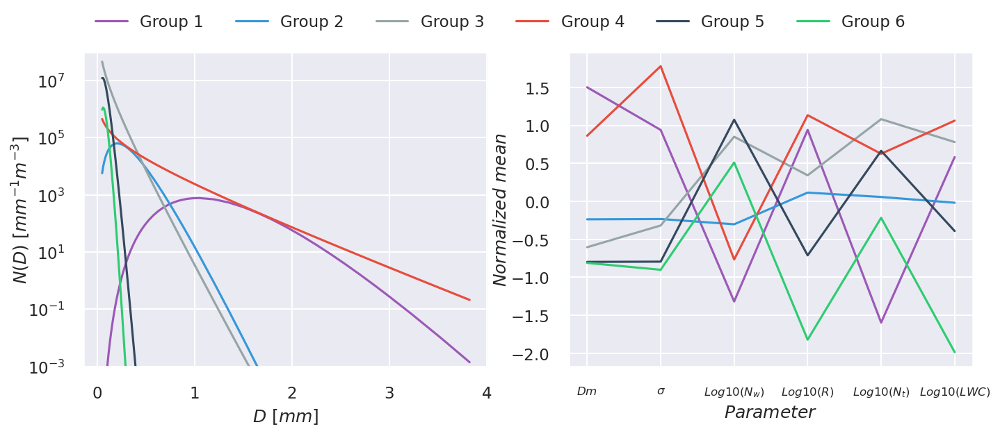

In [102]:
fig, (ax1, ax) = plt.subplots(1, 2, figsize=(11,4), dpi=150)

ax1.set_yscale('log')
ax1.set_ylim(1e-3, 1e8)
d = ds.diameter/1000
ax1.grid('both')
n = df['kmeans_6'].max() + 1
ax1.set_ylabel("$N(D) \  [mm^{-1}m^{-3}]$", labelpad=-3)
ax1.set_xlabel("$D\ [mm]$")
# colors = pl.cm.jet(np.linspace(0,1,n))
dm_t, sigma_t, nw_t, r_t, nt_t, lwc_t, group = [], [], [], [], [], [], []
for i in range(0,n):
    df_sub = df[df['kmeans_6'] == i]
    mu = df_sub['mu'].mean()
    dm = df_sub['dm'].mean()
    nw = 10 ** (df_sub['log10_nw'].mean())
    gm = norm_gamma(d, nw=nw, mu=mu, dm=dm)
    dm_t.append(df_sub['dm_T'].mean())
    sigma_t.append(df_sub['sigma_T'].mean())
    nw_t.append(df_sub['log10_nw_T'].mean())
    r_t.append(df_sub['logr_T'].mean())
    nt_t.append(df_sub['lognt_T'].mean())
    lwc_t.append(df_sub['loglwc_T'].mean())
    group.append(i+1)
    ax1.plot(ds.diameter/1000, gm, c=colors6[i], label=f"Group {i + 1}")
# ax1.legend()

lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
fig.legend(lines, labels, loc='upper center', ncol=6)

df_t = pd.DataFrame(data=np.squeeze(np.dstack([dm_t, sigma_t, nw_t, r_t, nt_t, lwc_t, group])), index=[f"Group {i}" for i in range(1, 7)], 
                   columns=['Dm', 'sigma', 'Log10(Nw)', 'Log10(R)', "Log10(Nt)", "Log10(LWC)", "Group"]).T
for idx, i in enumerate(df_t.columns):
    ax.plot(df_t[i][:-1], c=colors6[idx] )
ticks = ax.get_xticks(minor=False)
ax.set_ylabel("$Normalized \ mean$", labelpad=1)
ax.set_xlabel("$Parameter$")
ax.set_xticklabels([r'$Dm$', '$\sigma$', '$Log10(N_w)$', '$Log10(R)$', "$Log10(N_t)$", "$Log10(LWC)$", ], size=8)

In [103]:
ticks

[0, 1, 2, 3, 4, 5]

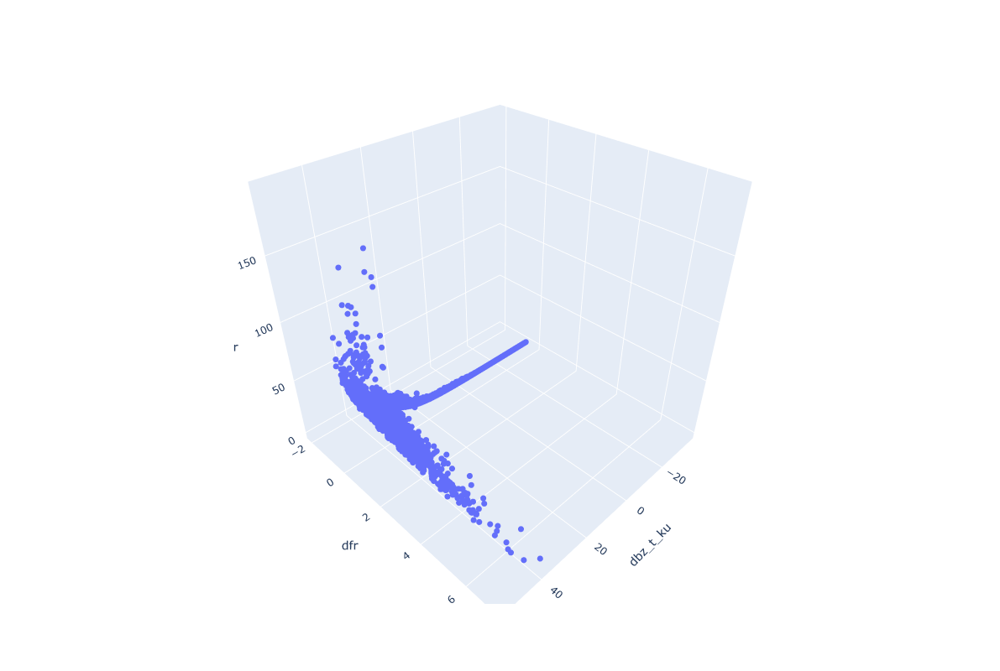

In [107]:
import plotly.express as px
fig = px.scatter_3d(df, x='dbz_t_ku', y='dfr', z='r',
             width=800, height=800)
fig.update_traces(marker_size = 4)
fig.show()

In [105]:
df_res = df.set_index(df['time'])

In [106]:
df

,time,sigma,sigmap,dm,log10_nw,mu,r,dfr,dbz_t_ka,dbz_t_ku,...,pca1,pca2,pca3,UM1,UM2,UM3,ISO1,ISO2,ISO3,kmeans_iso
0,2019-09-07 00:50:13,0.638638,0.523877,1.274745,3.835770,-0.015834,3.628710,-0.325355,32.279607,31.954252,...,2.658424,1.409054,0.553064,14.106030,9.402837,3.099502,3.987576,-1.162144,0.203610,3
1,2019-09-07 00:50:14,0.647497,0.527611,1.285212,3.962426,-0.060199,5.048991,0.570816,33.265364,33.836180,...,2.763166,1.205889,0.477602,14.132522,9.371662,3.237183,4.031414,-0.924104,0.128670,3
2,2019-09-07 00:50:17,0.268457,0.254001,1.070191,4.282757,11.891776,4.585315,-1.350772,30.202350,28.851578,...,1.774123,1.293192,-0.767447,14.931200,9.034312,0.050088,2.376533,-1.434724,0.982131,0
3,2019-09-07 00:50:18,0.900706,0.602119,1.638093,3.694672,-0.692414,8.350649,4.316825,35.384742,39.701567,...,3.763722,1.066914,1.159389,13.982682,9.603840,4.365051,5.086310,-0.657491,-0.416628,3
4,2019-09-07 00:50:19,0.529944,0.440128,1.255558,3.979833,1.613243,4.789344,0.729217,31.995297,32.724514,...,2.516061,1.337034,0.073452,14.278766,9.397261,2.489126,3.563861,-1.211560,0.445900,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8740,2019-10-05 07:14:20,0.222402,0.249406,0.860374,4.294626,10.965761,1.639645,-1.064085,23.417793,22.353709,...,1.184722,1.712157,-0.632230,14.086295,9.450970,-0.513375,2.123329,-1.773371,1.390152,0
8741,2019-10-05 07:14:23,0.385260,0.330671,1.222033,3.872777,6.061416,3.343195,-1.768849,30.839838,29.070989,...,2.123615,1.627208,-0.292126,14.539393,9.650543,1.028541,3.091687,-1.553260,0.954883,0
8742,2019-10-05 07:14:27,0.361556,0.266949,1.489003,3.804213,12.960578,7.357044,-1.897602,35.797127,33.899526,...,2.562517,1.390407,-0.586606,15.379603,9.467532,1.701805,3.330546,-1.517150,0.827987,0
8743,2019-10-05 07:14:28,0.536839,0.397728,1.482319,3.740727,3.624216,6.102195,-1.715149,35.663458,33.948309,...,2.824491,1.349415,0.074271,14.621273,9.447032,2.810053,3.948249,-1.297286,0.445526,3
